In [17]:
!pip install ultralytics

from IPython import display
display.clear_output()

In [18]:
import yaml
from ultralytics import YOLO
import random
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pathlib import Path
import pathlib
%matplotlib inline
from collections import Counter

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [19]:
with open('/kaggle/input/bccd-complete/BCCD/data.yaml', 'r') as f:
    data_yaml = yaml.safe_load(f)

data_yaml['train'] = '/kaggle/input/bccd-complete/BCCD/train'
data_yaml['val'] = '/kaggle/input/bccd-complete/BCCD/valid'
data_yaml['test'] = '/kaggle/input/bccd-complete/BCCD/test'

with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f)

In [20]:
data_yaml

{'names': ['Platelets', 'RBC', 'WBC'],
 'nc': 3,
 'test': '/kaggle/input/bccd-complete/BCCD/test',
 'train': '/kaggle/input/bccd-complete/BCCD/train',
 'val': '/kaggle/input/bccd-complete/BCCD/valid'}

In [21]:
data_dir = Path("/kaggle/input/bccd-complete/BCCD")
images_dir = data_dir / "train" / "images"
labels_dir = data_dir / "train" / "labels"

test_img_dir = data_dir / "test" / "images"
test_label_dir = data_dir / "test" / "labels"

class_names = data_yaml['names']

image_paths = list(images_dir.glob("*.jpg"))
label_paths = sorted(labels_dir.glob("*.txt"))

In [22]:
def save_segmented(segment, clazz, image_name):
    output_dir = pathlib.Path("segmented_images") / clazz
    output_dir.mkdir(parents=True, exist_ok=True)
    output_path = output_dir / f"{image_name}_{clazz}.jpg"
    cv2.imwrite(str(output_path), segment)


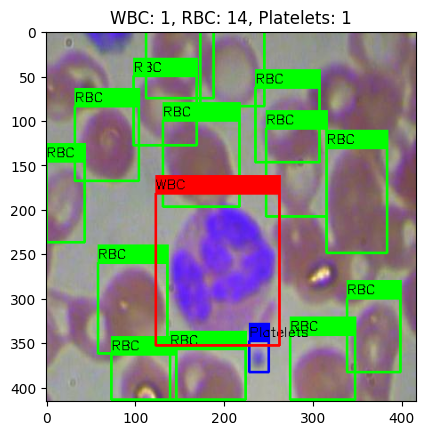

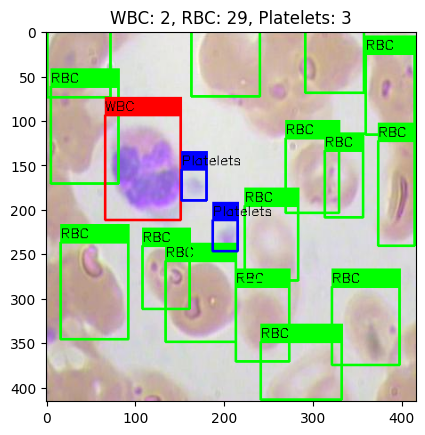

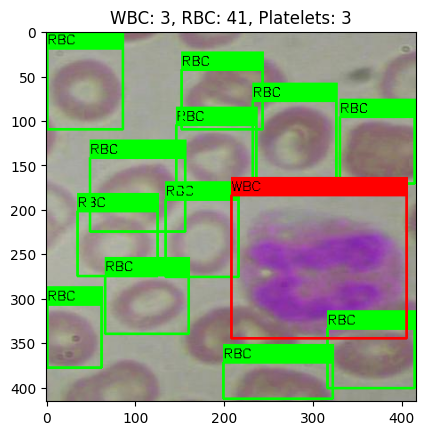

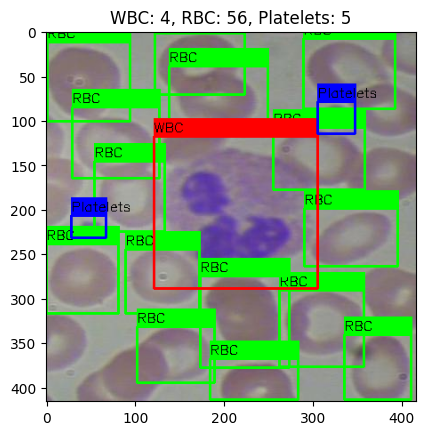

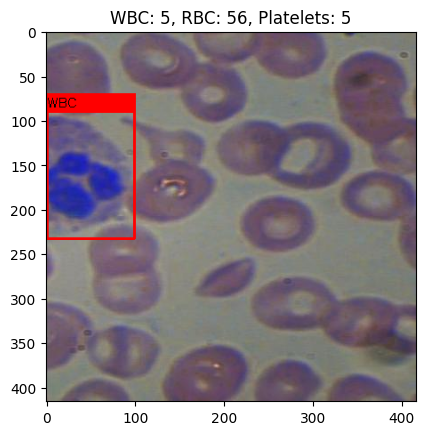

...

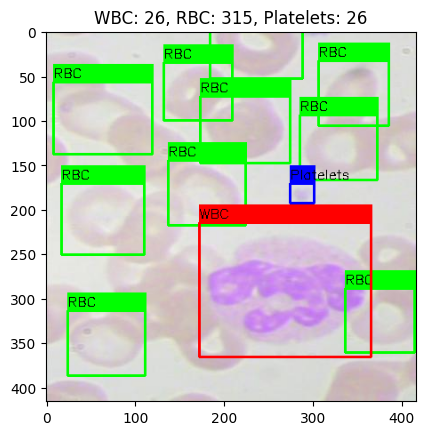

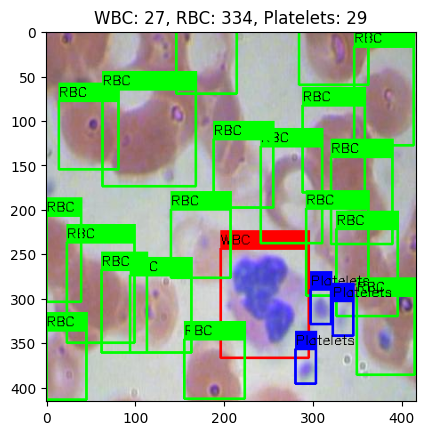

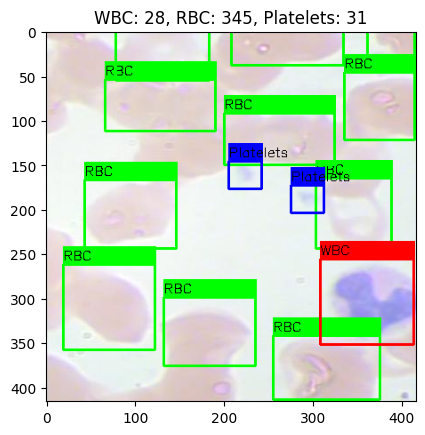

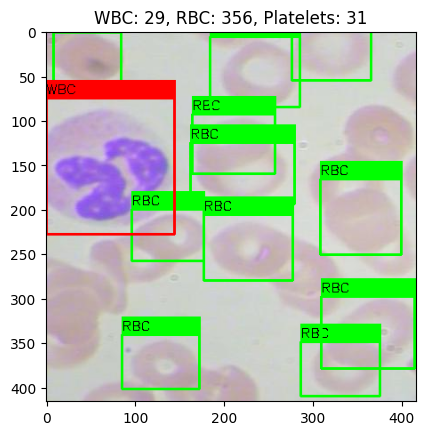

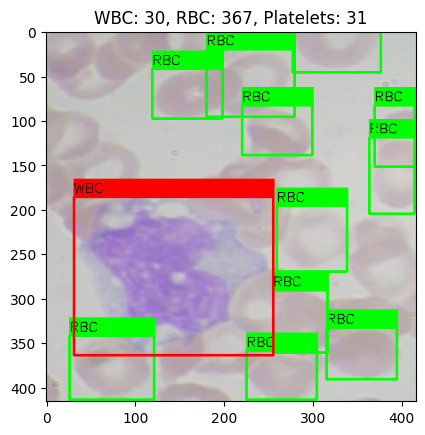

Total WBC count: 30
Total RBC count: 367
Total Platelet count: 31


In [23]:
import pathlib
import random
import cv2
import matplotlib.pyplot as plt

num_images = 30
image_files = [f for f in pathlib.Path(images_dir).iterdir() if f.is_file()]
random.shuffle(image_files)
selected_image_files = image_files[:num_images]

# Initialize counters
wbc_count = 0
rbc_count = 0
platelet_count = 0
for selected_image_file in selected_image_files:
    demo_image = selected_image_file
    demo_label = pathlib.Path(labels_dir) / f"{selected_image_file.stem}.txt"
    image = cv2.imread(str(demo_image))
    class_list = data_yaml['names']
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255)]  # Blue, Green, Red
    height, width, _ = image.shape

    with open(demo_label, "r") as file1:
        for line in file1.readlines():
            split = line.split(" ")
            class_id = int(split[0])

            # Count each class occurrence
            if class_id == 2:
                wbc_count += 1
            elif class_id == 1:
                rbc_count += 1
            elif class_id == 0:
                platelet_count += 1

            color = colors[class_id]
            clazz = class_list[class_id]

            x, y, w, h = float(split[1]), float(split[2]), float(split[3]), float(split[4])
            box = [int((x - 0.5 * w) * width), int((y - 0.5 * h) * height), int(w * width), int(h * height)]
            cv2.rectangle(image, box, color, 2)
            cv2.rectangle(image, (box[0], box[1] - 20), (box[0] + box[2], box[1]), color, -1)
            cv2.putText(image, clazz, (box[0], box[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0))

            # Extract and save the segmented object
            # Ensure bounding box coordinates are within image boundaries
            x1, y1, w, h = box
            x2 = min(x1 + w, width)
            y2 = min(y1 + h, height)

            if x1 < 0 or y1 < 0 or x2 > width or y2 > height:
                print(f"Skipping invalid segment: {box}")
                continue

            segment = image[y1:y2, x1:x2]
            save_segmented(segment, clazz, selected_image_file.stem)

        # Display the image with bounding boxes and counts
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        image = cv2.resize(image, (600, 600))
        plt.title(f'WBC: {wbc_count}, RBC: {rbc_count}, Platelets: {platelet_count}')
        plt.show()

# Print final counts after processing all images
print(f"Total WBC count: {wbc_count}")
print(f"Total RBC count: {rbc_count}")
print(f"Total Platelet count: {platelet_count}")


In [24]:
def test_inference(model):

    num_images = 2
    image_files = [f for f in pathlib.Path(test_img_dir).iterdir() if f.is_file()]
    random.shuffle(image_files)
    selected_image_files = image_files[:num_images]

    results = model(selected_image_files)
    i = 0
    for result in results:
        boxes = result.boxes
        masks = result.masks
        keypoints = result.keypoints
        probs = result.probs

        image_file = selected_image_files[i]
        i = i + 1
        image = cv2.imread(str(image_file))

        for b in boxes:
            xywh = b.xywh
            x = int(xywh[0][0].item())
            y = int(xywh[0][1].item())
            w = int(xywh[0][2].item())
            h = int(xywh[0][3].item())
            conf = b.conf.item()

            class_id = int(b.cls.item())
            color = colors[class_id]
            clazz = class_list[class_id]

            w2 = int(w/2)
            h2 = int(h/2)
            box = [x-w2,y-h2,w,h]

            cv2.rectangle(image, box, color, 2)

            cv2.rectangle(image, (box[0], box[1] - 20), (box[0] + box[2], box[1]), color, -1)

            cap = f'{clazz}: {conf:.2f}'
            cv2.putText(image, cap, (box[0], box[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, .5, (0,0,0))


        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.show()

In [25]:
params = {
    'data':'data.yaml',
    'imgsz':416,
    'epochs':75,
    'optimizer':'Adam',
    #'pretrained':True,
    'pretrained':False,
    'lr0':0.1,
    'lrf': 0.00001,
    'cos_lr': True
}

In [26]:
model_1 = YOLO('yolov8s.yaml')

In [27]:
results = model_1.train(**params)

Ultralytics 8.3.103 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=data.yaml, epochs=75, time=None, patience=100, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=False, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_wi

100%|██████████| 755k/755k [00:00<00:00, 15.6MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.9MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/bccd-complete/BCCD/train/labels... 765 images, 0 backgrounds, 0 corrupt: 100%|██████████| 765/765 [00:01<00:00, 422.55it/s]

train: WARNING ⚠️ Cache directory /kaggle/input/bccd-complete/BCCD/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/bccd-complete/BCCD/valid/labels... 73 images, 0 backgrounds, 0 corrupt: 100%|██████████| 73/73 [00:00<00:00, 334.61it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/bccd-complete/BCCD/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: Adam(lr=0.1, momentum=0.937) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 75 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/75       1.8G      3.466      2.831      3.073        350        416: 100%|██████████| 48/48 [00:08<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.58it/s]

                   all         73        967          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/75      2.13G      2.888      2.401      2.537        215        416: 100%|██████████| 48/48 [00:06<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.04it/s]

                   all         73        967      0.337      0.324    0.00402   0.000999



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/75      2.13G      2.431      2.238      2.385        293        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.75it/s]

                   all         73        967      0.386      0.116     0.0445     0.0109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/75      2.13G      2.276       2.42      2.334        256        416: 100%|██████████| 48/48 [00:06<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.28it/s]

                   all         73        967      0.736      0.134     0.0819     0.0221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/75      2.13G       2.11      2.163      2.179        314        416: 100%|██████████| 48/48 [00:06<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.10it/s]

                   all         73        967      0.753      0.103      0.148     0.0508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/75      2.13G      2.009      1.917      2.139        234        416: 100%|██████████| 48/48 [00:06<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.44it/s]

                   all         73        967      0.208      0.503      0.319      0.115



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/75      2.13G      1.917      1.765      2.053        275        416: 100%|██████████| 48/48 [00:06<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.25it/s]

                   all         73        967      0.438      0.398      0.382      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/75      2.13G      1.886      1.686      2.008        288        416: 100%|██████████| 48/48 [00:06<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.19it/s]

                   all         73        967      0.478      0.144      0.247      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/75      2.13G      1.842      1.593      2.002        325        416: 100%|██████████| 48/48 [00:06<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.01it/s]

                   all         73        967      0.525      0.219      0.291      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/75      2.13G      1.827      1.565      1.973        200        416: 100%|██████████| 48/48 [00:06<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.62it/s]

                   all         73        967      0.543      0.373      0.452       0.19



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/75      2.13G      1.803      1.534      1.954        255        416: 100%|██████████| 48/48 [00:06<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.34it/s]

                   all         73        967      0.584      0.487      0.573      0.249



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/75      2.13G      1.759      1.463      1.895        321        416: 100%|██████████| 48/48 [00:06<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.12it/s]

                   all         73        967      0.609      0.531      0.578      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/75      2.13G      1.768       1.43      1.921        247        416: 100%|██████████| 48/48 [00:06<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.37it/s]

                   all         73        967      0.464      0.524      0.616       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/75      2.13G      1.758      1.464      1.914        302        416: 100%|██████████| 48/48 [00:06<00:00,  7.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.61it/s]

                   all         73        967      0.638      0.506      0.617      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/75      2.13G      1.718      1.413      1.867        250        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.65it/s]

                   all         73        967      0.625      0.651      0.697       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/75      2.13G      1.684      1.421      1.879        289        416: 100%|██████████| 48/48 [00:06<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.65it/s]

                   all         73        967      0.665      0.746      0.745      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/75      2.13G      1.683      1.379      1.848        193        416: 100%|██████████| 48/48 [00:06<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.72it/s]

                   all         73        967      0.722      0.626      0.771      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/75      2.13G      1.658      1.333      1.823        245        416: 100%|██████████| 48/48 [00:06<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.06it/s]

                   all         73        967      0.526      0.732      0.655      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/75      2.13G      1.632      1.315      1.805        219        416: 100%|██████████| 48/48 [00:06<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.86it/s]

                   all         73        967      0.582      0.535      0.545      0.243



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/75      2.13G        1.6      1.299      1.781        223        416: 100%|██████████| 48/48 [00:06<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.79it/s]

                   all         73        967      0.458      0.445      0.456      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/75      2.13G      1.599      1.256      1.754        300        416: 100%|██████████| 48/48 [00:06<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.52it/s]

                   all         73        967       0.61       0.71      0.725      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/75      2.13G      1.586      1.271      1.761        279        416: 100%|██████████| 48/48 [00:06<00:00,  7.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.80it/s]

                   all         73        967      0.758      0.294      0.407      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/75      2.13G      1.595      1.286      1.763        294        416: 100%|██████████| 48/48 [00:06<00:00,  7.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.18it/s]

                   all         73        967      0.582      0.746      0.764      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/75      2.13G       1.56      1.227      1.738        294        416: 100%|██████████| 48/48 [00:06<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.68it/s]

                   all         73        967       0.68       0.44      0.482      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/75      2.13G      1.568      1.256      1.756        276        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.00it/s]

                   all         73        967      0.815      0.432      0.758      0.376



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/75      2.13G      1.569      1.243      1.737        265        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.77it/s]

                   all         73        967      0.806      0.571       0.72       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/75      2.13G      1.544      1.231      1.724        346        416: 100%|██████████| 48/48 [00:06<00:00,  7.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.45it/s]

                   all         73        967      0.612      0.434      0.528      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/75      2.13G      1.536      1.219      1.708        314        416: 100%|██████████| 48/48 [00:06<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.54it/s]

                   all         73        967      0.721      0.773      0.821      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/75      2.13G      1.527      1.188      1.712        307        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.64it/s]

                   all         73        967       0.55        0.6      0.646       0.32



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/75      2.13G       1.55      1.194       1.73        349        416: 100%|██████████| 48/48 [00:06<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.53it/s]

                   all         73        967      0.686      0.562      0.604      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/75      2.13G      1.492      1.169      1.679        287        416: 100%|██████████| 48/48 [00:06<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.92it/s]

                   all         73        967      0.731      0.706        0.8      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/75      2.13G       1.49      1.173      1.681        257        416: 100%|██████████| 48/48 [00:06<00:00,  7.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.09it/s]

                   all         73        967      0.566      0.822       0.78      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/75      2.13G      1.499      1.155      1.677        367        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.23it/s]

                   all         73        967      0.753      0.819      0.828      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/75      2.13G      1.496      1.162      1.681        321        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.23it/s]

                   all         73        967      0.451       0.25     0.0717     0.0186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/75      2.13G      1.493       1.16      1.688        319        416: 100%|██████████| 48/48 [00:06<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.48it/s]

                   all         73        967      0.665      0.617      0.614      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/75      2.13G      1.484      1.143      1.681        266        416: 100%|██████████| 48/48 [00:06<00:00,  7.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.94it/s]

                   all         73        967      0.701      0.829      0.833      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/75      2.13G      1.475      1.115      1.657        225        416: 100%|██████████| 48/48 [00:06<00:00,  7.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.97it/s]

                   all         73        967      0.605      0.774      0.783      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/75      2.13G      1.442      1.105      1.632        310        416: 100%|██████████| 48/48 [00:06<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.61it/s]

                   all         73        967      0.742      0.811      0.833      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/75      2.13G      1.459      1.108      1.632        223        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.96it/s]

                   all         73        967      0.686      0.837       0.83      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/75      2.13G      1.446      1.122      1.651        224        416: 100%|██████████| 48/48 [00:06<00:00,  7.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  5.91it/s]

                   all         73        967      0.687      0.838      0.827      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/75      2.13G      1.437      1.098      1.654        325        416: 100%|██████████| 48/48 [00:06<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.11it/s]

                   all         73        967      0.749       0.82      0.825      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/75      2.13G      1.414      1.067      1.614        267        416: 100%|██████████| 48/48 [00:06<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.94it/s]

                   all         73        967      0.751      0.748      0.792      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/75      2.13G      1.401      1.065      1.612        213        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.08it/s]

                   all         73        967      0.733      0.878      0.845      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/75      2.13G       1.41      1.049      1.608        270        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.16it/s]

                   all         73        967      0.794      0.845      0.862       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/75      2.13G      1.403      1.052       1.61        298        416: 100%|██████████| 48/48 [00:06<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.30it/s]

                   all         73        967      0.726      0.861      0.843      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/75      2.13G        1.4      1.055      1.599        270        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.83it/s]

                   all         73        967      0.758       0.84      0.857      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/75      2.13G      1.388      1.042      1.594        311        416: 100%|██████████| 48/48 [00:06<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.68it/s]

                   all         73        967      0.761      0.871      0.871      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/75      2.13G      1.363      1.019      1.577        296        416: 100%|██████████| 48/48 [00:06<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.60it/s]

                   all         73        967      0.735      0.893      0.874      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/75      2.13G      1.363      1.024      1.574        284        416: 100%|██████████| 48/48 [00:06<00:00,  7.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.64it/s]

                   all         73        967      0.817       0.85      0.874       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/75      2.13G      1.375      1.007      1.568        277        416: 100%|██████████| 48/48 [00:06<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.09it/s]

                   all         73        967       0.74      0.859      0.867       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/75      2.13G      1.365      1.018      1.595        267        416: 100%|██████████| 48/48 [00:06<00:00,  7.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.90it/s]

                   all         73        967      0.775      0.851      0.867      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/75      2.13G       1.35          1      1.577        244        416: 100%|██████████| 48/48 [00:06<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.89it/s]

                   all         73        967       0.75       0.81      0.845      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/75      2.13G      1.359      1.013      1.575        306        416: 100%|██████████| 48/48 [00:06<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.65it/s]

                   all         73        967      0.755       0.88      0.875      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/75      2.13G       1.33     0.9899      1.556        282        416: 100%|██████████| 48/48 [00:06<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.69it/s]

                   all         73        967      0.763      0.871      0.866      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/75      2.13G      1.335     0.9934      1.548        269        416: 100%|██████████| 48/48 [00:06<00:00,  7.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.99it/s]

                   all         73        967      0.766      0.886      0.873      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/75      2.13G      1.331     0.9745      1.563        272        416: 100%|██████████| 48/48 [00:06<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.04it/s]

                   all         73        967      0.741       0.87      0.884      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/75      2.13G      1.314     0.9798      1.552        339        416: 100%|██████████| 48/48 [00:06<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.79it/s]

                   all         73        967      0.792      0.837      0.871      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/75      2.13G      1.294     0.9489       1.53        283        416: 100%|██████████| 48/48 [00:06<00:00,  7.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.07it/s]

                   all         73        967      0.806      0.911       0.89      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/75      2.13G      1.311     0.9631      1.538        235        416: 100%|██████████| 48/48 [00:06<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.71it/s]

                   all         73        967      0.834      0.872      0.897      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/75      2.13G      1.314     0.9675      1.538        252        416: 100%|██████████| 48/48 [00:06<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.56it/s]

                   all         73        967      0.803      0.881      0.888      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/75      2.13G      1.287     0.9401      1.527        244        416: 100%|██████████| 48/48 [00:06<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.27it/s]

                   all         73        967      0.759      0.882      0.885      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/75      2.13G      1.288     0.9366      1.513        247        416: 100%|██████████| 48/48 [00:06<00:00,  7.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.05it/s]

                   all         73        967       0.79       0.91      0.886      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/75      2.13G      1.298     0.9395      1.531        312        416: 100%|██████████| 48/48 [00:06<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.96it/s]

                   all         73        967      0.812      0.874      0.893      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/75      2.13G      1.269     0.9163      1.492        319        416: 100%|██████████| 48/48 [00:06<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.94it/s]

                   all         73        967      0.781      0.902      0.892      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/75      2.13G      1.278     0.9257      1.502        199        416: 100%|██████████| 48/48 [00:06<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.20it/s]

                   all         73        967      0.789      0.921      0.897      0.578


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/75      2.13G      1.264     0.9335      1.613        172        416: 100%|██████████| 48/48 [00:06<00:00,  7.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.16it/s]

                   all         73        967      0.766      0.912       0.89      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/75      2.13G      1.243     0.9043      1.583        171        416: 100%|██████████| 48/48 [00:06<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.29it/s]

                   all         73        967      0.799      0.916      0.894      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/75      2.13G      1.243     0.9021      1.589        180        416: 100%|██████████| 48/48 [00:06<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.20it/s]

                   all         73        967      0.797      0.917      0.893      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/75      2.13G      1.244     0.9057      1.609        171        416: 100%|██████████| 48/48 [00:06<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.98it/s]

                   all         73        967      0.802      0.922      0.897      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/75      2.13G      1.234     0.8901      1.575        143        416: 100%|██████████| 48/48 [00:06<00:00,  7.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.26it/s]

                   all         73        967       0.79       0.92      0.898      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/75      2.13G      1.236     0.8929      1.589        188        416: 100%|██████████| 48/48 [00:06<00:00,  7.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.63it/s]

                   all         73        967      0.795      0.927      0.898      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/75      2.13G      1.225     0.8815       1.57        172        416: 100%|██████████| 48/48 [00:06<00:00,  7.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  7.35it/s]

                   all         73        967      0.803      0.921      0.898      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/75      2.13G      1.223     0.8824      1.584        182        416: 100%|██████████| 48/48 [00:06<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.66it/s]

                   all         73        967      0.806      0.924      0.901      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/75      2.13G      1.222     0.8833      1.577        175        416: 100%|██████████| 48/48 [00:06<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.94it/s]

                   all         73        967        0.8      0.925        0.9      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/75      2.13G      1.225     0.8851      1.568        169        416: 100%|██████████| 48/48 [00:06<00:00,  7.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.87it/s]

                   all         73        967      0.799      0.929      0.899      0.593



75 epochs completed in 0.154 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 22.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.103 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.60it/s]


                   all         73        967        0.8      0.929      0.899      0.593
             Platelets         42         76      0.774        0.9      0.869      0.477
                   RBC         72        819      0.686      0.886      0.858      0.593
                   WBC         71         72      0.939          1      0.971       0.71
Speed: 0.2ms preprocess, 2.5ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train


In [28]:
results.confusion_matrix.print()

70.0 0.0 0.0 26.0
0.0 771.0 0.0 453.0
1.0 0.0 72.0 3.0
5.0 48.0 0.0 0.0


In [29]:
model_2 =  YOLO('/kaggle/working/runs/detect/train/weights/best.pt')
res = model_2.val()

Ultralytics 8.3.103 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
YOLOv8s summary (fused): 72 layers, 11,126,745 parameters, 0 gradients, 28.4 GFLOPs


val: Scanning /kaggle/input/bccd-complete/BCCD/valid/labels... 73 images, 0 backgrounds, 0 corrupt: 100%|██████████| 73/73 [00:00<00:00, 835.38it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/bccd-complete/BCCD/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]


                   all         73        967        0.8      0.929      0.899       0.59
             Platelets         42         76      0.774      0.899      0.868      0.471
                   RBC         72        819      0.687      0.886      0.857      0.592
                   WBC         71         72      0.939          1      0.971      0.707
Speed: 2.6ms preprocess, 7.9ms inference, 0.0ms loss, 12.9ms postprocess per image
Results saved to runs/detect/val



0: 416x416 18 RBCs, 1 WBC, 18.8ms
1: 416x416 2 Plateletss, 22 RBCs, 1 WBC, 18.8ms
Speed: 0.7ms preprocess, 18.8ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 416)


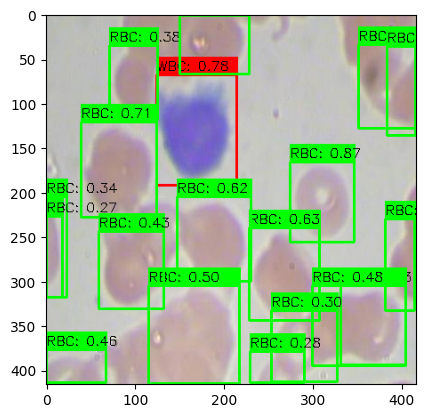

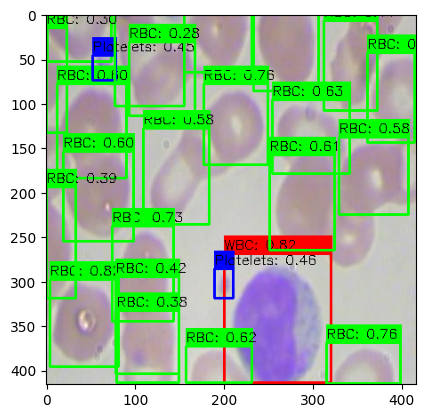

In [30]:
test_inference(model_2)

In [31]:
from pathlib import Path

def load_ground_truth_labels(label_dir):
    ground_truths = {}
    label_files = sorted(label_dir.glob("*.txt"))
    for label_file in label_files:
        image_id = label_file.stem
        with open(label_file, "r") as f:
            labels = [line.strip().split() for line in f.readlines()]
        ground_truths[image_id] = [(int(label[0]), float(label[1]), float(label[2]), float(label[3]), float(label[4])) for label in labels]
    return ground_truths

# Load ground truth labels
ground_truths = load_ground_truth_labels(test_label_dir)

In [32]:
def get_predictions(model, img_dir):
    results = model.predict(conf=0.25, source=str(img_dir))
    predictions = {}
    for result in results:
        image_id = Path(result.path).stem
        predictions[image_id] = [(int(box.cls.item()), box.conf.item(), box.xywh) for box in result.boxes]
    return predictions


In [33]:
predictions = get_predictions(model_2, test_img_dir)


image 1/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00038_jpg.rf.ffa23e4b5b55b523367f332af726eae8.jpg: 416x416 1 Platelets, 20 RBCs, 1 WBC, 10.7ms
image 2/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00044_jpg.rf.e7760375eba4bc20c5746367e2311e18.jpg: 416x416 3 Plateletss, 16 RBCs, 2 WBCs, 9.9ms
image 3/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00062_jpg.rf.1be1ca0ecdf783798fc10346baaa203e.jpg: 416x416 3 Plateletss, 18 RBCs, 1 WBC, 9.9ms
image 4/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00090_jpg.rf.cdbf8f6ed3b93fa902a0bc991132cb40.jpg: 416x416 3 Plateletss, 14 RBCs, 1 WBC, 9.9ms
image 5/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00099_jpg.rf.e3c42cd68359527494a53843479dff5c.jpg: 416x416 2 Plateletss, 19 RBCs, 1 WBC, 9.9ms
image 6/36 /kaggle/input/bccd-complete/BCCD/test/images/BloodImage_00112_jpg.rf.978cec39235980055c2ad7ff8b6f1912.jpg: 416x416 1 Platelets, 24 RBCs, 1 WBC, 9.9ms
image 7/36 /kaggle/input/bc

In [34]:
def calculate_accuracy(predictions, ground_truths):
    correct_predictions = 0
    total_predictions = 0

    for image_id, predicted_boxes in predictions.items():
        if image_id in ground_truths:
            ground_truth_boxes = ground_truths[image_id]
            for predicted_box in predicted_boxes:
                predicted_class = predicted_box[0]
                for ground_truth_box in ground_truth_boxes:
                    ground_truth_class = ground_truth_box[0]
                    if predicted_class == ground_truth_class:
                        correct_predictions += 1
                        break
            total_predictions += len(predicted_boxes)

    accuracy = correct_predictions / total_predictions if total_predictions > 0 else 0
    return accuracy

In [35]:
def calculate_class_accuracy(predictions, ground_truths, target_class):
    correct_predictions = 0
    total_predictions = 0

    for image_id, predicted_boxes in predictions.items():
        if image_id in ground_truths:
            ground_truth_boxes = ground_truths[image_id]
            for predicted_box in predicted_boxes:
                predicted_class = predicted_box[0]
                if predicted_class == target_class:
                    total_predictions += 1
                    for ground_truth_box in ground_truth_boxes:
                        ground_truth_class = ground_truth_box[0]
                        if predicted_class == ground_truth_class:
                            correct_predictions += 1
                            break

    accuracy = correct_predictions / total_predictions if total_predictions > 0 else 0
    return accuracy

RBC_CLASS = 0
WBC_CLASS = 1
PLATELET_CLASS = 2

In [36]:
# Calculate overall accuracy
overall_accuracy = calculate_accuracy(predictions, ground_truths)

# Calculate accuracy for each class
rbc_accuracy = calculate_class_accuracy(predictions, ground_truths, RBC_CLASS)
wbc_accuracy = calculate_class_accuracy(predictions, ground_truths, WBC_CLASS)
platelet_accuracy = calculate_class_accuracy(predictions, ground_truths, PLATELET_CLASS)

print(f'Overall Prediction Accuracy: {overall_accuracy:.2%}')
print(f'RBC Prediction Accuracy: {rbc_accuracy:.2%}')
print(f'WBC Prediction Accuracy: {wbc_accuracy:.2%}')
print(f'Platelet Prediction Accuracy: {platelet_accuracy:.2%}')

Overall Prediction Accuracy: 95.49%
RBC Prediction Accuracy: 85.71%
WBC Prediction Accuracy: 95.94%
Platelet Prediction Accuracy: 97.44%


In [52]:
#Pretrained CNN

In [37]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        os.path.join(dirname, filename)

In [38]:
import pandas as pd
import numpy as np
import keras
import warnings
warnings.filterwarnings(action="ignore")
import matplotlib.pyplot as plt
%matplotlib inline

from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K


from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [39]:
import os
import pandas as pd

EOSINOPHIL_dirs = [r'/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TRAIN/EOSINOPHIL']
LYMPHOCYTE_dirs = [r'/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TRAIN/LYMPHOCYTE']
MONOCYTE_dirs = [r'/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TRAIN/MONOCYTE']
NEUTROPHIL_dirs = [r'/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TRAIN/NEUTROPHIL']

filepaths = []
labels = []
dict_lists = [EOSINOPHIL_dirs, LYMPHOCYTE_dirs, MONOCYTE_dirs, NEUTROPHIL_dirs]
class_labels = ['EOSINOPHIL', 'LYMPHOCYTE', 'MONOCYTE', 'NEUTROPHIL']

for i, dir_list in enumerate(dict_lists):
    for j in dir_list:
        flist = os.listdir(j)
        for f in flist:
            fpath = os.path.join(j, f)
            filepaths.append(fpath)
            labels.append(class_labels[i])

Fseries = pd.Series(filepaths, name="filepaths")
Lseries = pd.Series(labels, name="labels")
bloodCell_data = pd.concat([Fseries, Lseries], axis=1)
bloodCell_df = pd.DataFrame(bloodCell_data)
print(bloodCell_df.head())
print(bloodCell_df["labels"].value_counts())

                                           filepaths      labels
0  /kaggle/input/blood-cells/dataset2-master/data...  EOSINOPHIL
1  /kaggle/input/blood-cells/dataset2-master/data...  EOSINOPHIL
2  /kaggle/input/blood-cells/dataset2-master/data...  EOSINOPHIL
3  /kaggle/input/blood-cells/dataset2-master/data...  EOSINOPHIL
4  /kaggle/input/blood-cells/dataset2-master/data...  EOSINOPHIL
labels
NEUTROPHIL    2499
EOSINOPHIL    2497
LYMPHOCYTE    2483
MONOCYTE      2478
Name: count, dtype: int64


In [40]:
bloodCell_df.shape

(9957, 2)

In [41]:
train_images, test_images = train_test_split(bloodCell_df, test_size=0.3, random_state=42)
train_set, val_set = train_test_split(bloodCell_df, test_size=0.2, random_state=42)

In [42]:
print(train_set.shape)
print(test_images.shape)
print(val_set.shape)
print(train_images.shape)

(7965, 2)
(2988, 2)
(1992, 2)
(6969, 2)


In [43]:
image_gen = ImageDataGenerator(preprocessing_function= tf.keras.applications.mobilenet_v2.preprocess_input)
train = image_gen.flow_from_dataframe(dataframe= train_set,x_col="filepaths",y_col="labels",
                                      target_size=(244,244),
                                      color_mode='rgb',
                                      class_mode="categorical", 
                                      batch_size=8,
                                      shuffle=True            
                                     )
test = image_gen.flow_from_dataframe(dataframe= test_images,x_col="filepaths", y_col="labels",
                                     target_size=(244,244),
                                     color_mode='rgb',
                                     class_mode="categorical",
                                     batch_size=8,
                                     shuffle= False
                                    )
val = image_gen.flow_from_dataframe(dataframe= val_set,x_col="filepaths", y_col="labels",
                                    target_size=(244,244),
                                    color_mode= 'rgb',
                                    class_mode="categorical",
                                    batch_size=8,
                                    shuffle=False
                                   )

Found 7965 validated image filenames belonging to 4 classes.
Found 2988 validated image filenames belonging to 4 classes.
Found 1992 validated image filenames belonging to 4 classes.


In [44]:
classes=list(train.class_indices.keys())
print (classes)

['EOSINOPHIL', 'LYMPHOCYTE', 'MONOCYTE', 'NEUTROPHIL']


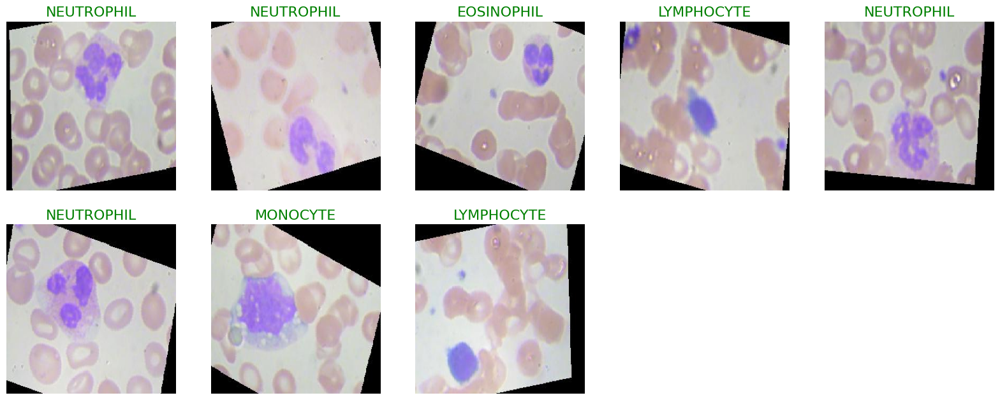

In [45]:
def show_knee_images(image_gen):
    test_dict = test.class_indices
    classes = list(test_dict.keys())
    images, labels=next(image_gen) # get a sample batch from the generator
    plt.figure(figsize=(20,20))
    length = len(labels)
    if length<25:
        r=length
    else:
        r=25
    for i in range(r):
        plt.subplot(5,5,i+1)
        image=(images[i]+1)/2 #scale images between 0 and 1
        plt.imshow(image)
        index=np.argmax(labels[i])
        class_name=classes[index]
        plt.title(class_name, color="green",fontsize=16)
        plt.axis('off')
    plt.show()
show_knee_images(train)

In [46]:
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import Precision, Recall
model = models.Sequential([
    layers.SeparableConv2D(filters=128, kernel_size=(8, 8), strides=(3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.BatchNormalization(),
    
    layers.SeparableConv2D(filters=128, kernel_size=(5, 5), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    
    layers.SeparableConv2D(filters=256, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.SeparableConv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.SeparableConv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(2, 2)),
    
    layers.SeparableConv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(2, 2)),
    
    layers.SeparableConv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(2, 2)),
    
    layers.SeparableConv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPool2D(pool_size=(2, 2)),
    
    layers.SeparableConv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),
    
    layers.GlobalAveragePooling2D(),
    
    layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dropout(0.5),
    layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dropout(0.5),
    layers.Dense(4, activation='softmax')
])

model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.optimizers.SGD(learning_rate=0.001),
    metrics=[Precision(), Recall(), 'accuracy']
)

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ separable_conv2d (SeparableConv2D)   │ (None, 73, 73, 128)         │             704 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 73, 73, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_1 (SeparableConv2D) │ (None, 73, 73, 128)         │          19,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 73, 73, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_2 (SeparableConv2D) │ (None, 73, 73, 256)         │          34,176 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 73, 73, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_3 (SeparableConv2D) │ (None, 73, 73, 256)         │          66,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 73, 73, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_4 (SeparableConv2D) │ (None, 73, 73, 256)         │          66,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 73, 73, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 36, 36, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_5 (SeparableConv2D) │ (None, 36, 36, 512)         │         133,888 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 36, 36, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 18, 18, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_6 (SeparableConv2D) │ (None, 18, 18, 512)         │         267,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 18, 18, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 9, 9, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ separable_conv2d_7 (SeparableConv2D) │ (None, 9, 9, 512)           │         267,2

 Total params: 2,713,668 (10.35 MB)

 Trainable params: 2,707,524 (10.33 MB)

 Non-trainable params: 6,144 (24.00 KB)

In [48]:
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping

# Define callbacks including EarlyStopping
callbacks = [
    ModelCheckpoint(filepath='best_model.keras', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)  # Added EarlyStopping
]

history = model.fit(train, epochs=50, validation_data=val, verbose=1,callbacks=callbacks)

Epoch 1/50
996/996 ━━━━━━━━━━━━━━━━━━━━ 100s 85ms/step - accuracy: 0.3313 - loss: 3.0607 - precision: 0.5140 - recall: 0.0103 - val_accuracy: 0.5813 - val_loss: 2.7621 - val_precision: 0.8363 - val_recall: 0.1667
Epoch 2/50
996/996 ━━━━━━━━━━━━━━━━━━━━ 53s 53ms/step - accuracy: 0.5873 - loss: 2.7080 - precision: 0.7862 - recall: 0.2823 - val_accuracy: 0.6089 - val_loss: 2.6195 - val_precision: 0.6621 - val_recall: 0.5577
Epoch 3/50
996/996 ━━━━━━━━━━━━━━━━━━━━ 52s 52ms/step - accuracy: 0.7678 - loss: 2.2839 - precision: 0.8394 - recall: 0.6647 - val_accuracy: 0.7254 - val_loss: 2.2923 - val_precision: 0.7618 - val_recall: 0.6792
Epoch 4/50
996/996 ━━━━━━━━━━━━━━━━━━━━ 52s 52ms/step - accuracy: 0.8388 - loss: 2.1097 - precision: 0.8787 - recall: 0.7875 - val_accuracy: 0.8469 - val_loss: 2.0522 - val_precision: 0.8744 - val_recall: 0.8178
Epoch 5/50
996/996 ━━━━━━━━━━━━━━━━━━━━ 52s 52ms/step - accuracy: 0.8653 - loss: 2.0409 - precision: 0.8944 - recall: 0.8346 - val_accuracy: 0.9378 - v

In [49]:
model.evaluate(test, verbose=1)

374/374 ━━━━━━━━━━━━━━━━━━━━ 11s 29ms/step - accuracy: 0.9939 - loss: 1.4216 - precision: 0.9939 - recall: 0.9939


[1.4136685132980347,
 0.9959839582443237,
 0.9959839582443237,
 0.9959839582443237]

In [50]:
pred = model.predict(test)
pred = np.argmax(pred, axis=1) #pick class with highest  probability

labels = (train.class_indices)
labels = dict((v,k) for k,v in labels.items())
pred2 = [labels[k] for k in pred]

374/374 ━━━━━━━━━━━━━━━━━━━━ 9s 21ms/step


In [51]:
from sklearn.metrics import confusion_matrix, accuracy_score

y_test = test_images.labels # set y_test to the expected output
print(classification_report(y_test, pred2))
print("Accuracy of the Model:","{:.1f}%".format(accuracy_score(y_test, pred2)*100))

              precision    recall  f1-score   support

  EOSINOPHIL       0.99      0.99      0.99       781
  LYMPHOCYTE       1.00      1.00      1.00       764
    MONOCYTE       1.00      1.00      1.00       729
  NEUTROPHIL       0.99      0.99      0.99       714

    accuracy                           1.00      2988
   macro avg       1.00      1.00      1.00      2988
weighted avg       1.00      1.00      1.00      2988

Accuracy of the Model: 99.6%


In [52]:
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
import matplotlib.pyplot as plt

def predict_image(img_path, model, class_names):
    # Load and preprocess image
    img = image.load_img(img_path, target_size=(244, 244))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    img_array = preprocess_input(img_array)

    # Make prediction
    predictions = model.predict(img_array)
    predicted_class = class_names[np.argmax(predictions)]
    confidence = np.max(predictions)

    # Display image with prediction
    plt.imshow(img)
    plt.title(f"Prediction: {predicted_class} ({confidence:.2f})")
    plt.axis('off')
    plt.show()

    return predicted_class, confidence


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


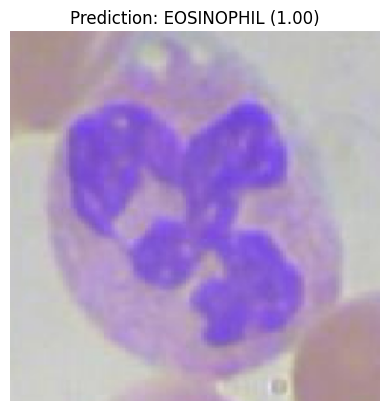

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


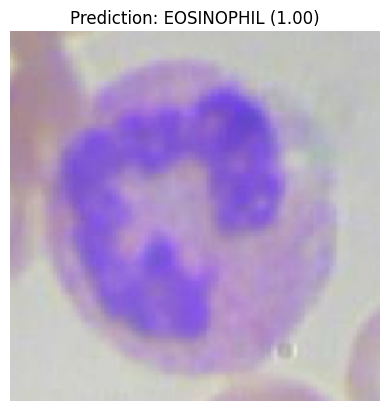

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


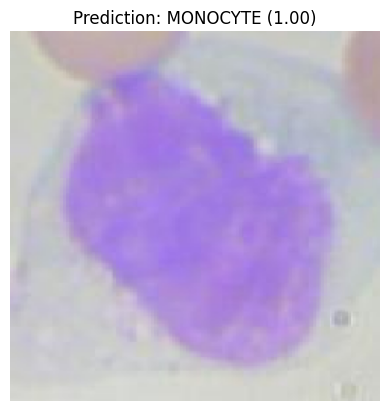

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


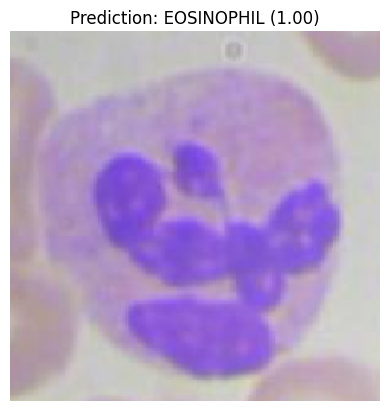

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


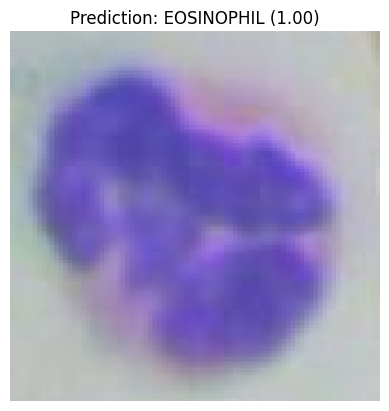

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


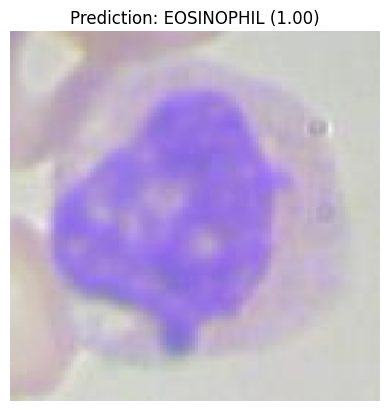

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


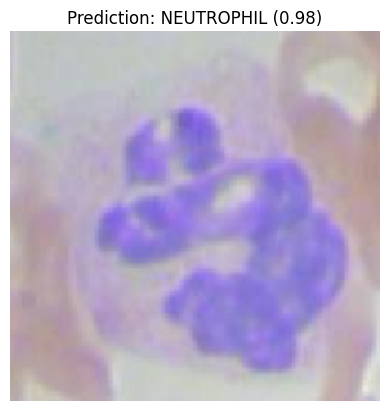

('NEUTROPHIL', 0.9846273)

In [96]:
# Example usage
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00216_jpg.rf.d2ee375678fba0f34f0aacf8e4742b18_WBC_17.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00221_jpg.rf.34c741c4c5a62ee8d902b3cd5fbda695_WBC_1.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00281_jpg.rf.eff4624a0f19df5fcda53a83073555c6_WBC_23.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00403_jpg.rf.b57c1c51f6ca6947949569cc80b35b4b_WBC_52.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00086_jpg.rf.0c41cbdcf1bdf6b266f28ca582a4eaeb_WBC_38.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00110_jpg.rf.c6de7f1aa76b35bfa563e7f1a5f94351_WBC_65.png"
predict_image(img_path, model, class_labels)
img_path = "/kaggle/working/segmented_cells/WBC/BloodImage_00004_jpg.rf.f693b02f76e9ef617d9d2a9de64a3990_WBC_41.png"
predict_image(img_path, model, class_labels)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


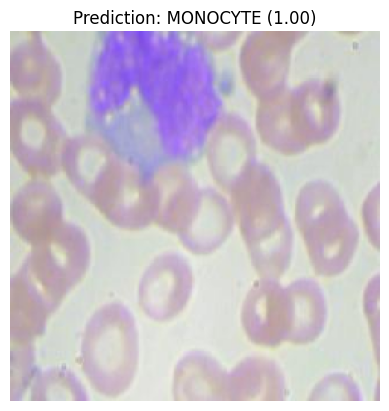

('MONOCYTE', 0.99997663)

In [93]:
# Example usage
img_path = "/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TEST_SIMPLE/MONOCYTE/_1_4511.jpeg"
predict_image(img_path, model, class_labels)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


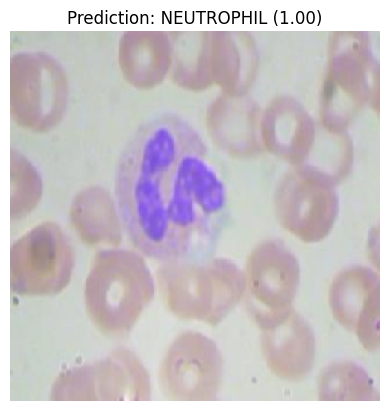

('NEUTROPHIL', 0.9999999)

In [72]:
# Example usage
img_path = "/kaggle/input/blood-cells/dataset2-master/dataset2-master/images/TEST_SIMPLE/NEUTROPHIL/_27_4190.jpeg"
predict_image(img_path, model, class_labels)

In [53]:
import numpy as np
import pickle
import warnings
warnings.filterwarnings("ignore")

In [54]:
with open("/kaggle/input/rf/scikitlearn/default/1/random_forest_model_1.pkl", "rb") as file:
    rf_model = pickle.load(file)
print(type(rf_model))

<class 'sklearn.ensemble._forest.RandomForestClassifier'>


In [55]:
import sklearn
print(sklearn.__version__)

1.2.2


In [58]:
age = 30                 # Patient Age
haemoglobin = 13.5       # Haemoglobin Level
esr = 12                 # Erythrocyte Sedimentation Rate
wbc = 6500               # White Blood Cell Count
neutrophil = 43         # Neutrophil Count
lymphocyte = 5          # Lymphocyte Count
monocyte = 5             # Monocyte Count
eosinophil = 3           # Eosinophil Count
basophil = 2             # Basophil Count
rbc = 4.8                # Red Blood Cell Count
platelets = 120       # Platelet Count

gender_female = 0  # Set to 1 if Female
gender_male = 1    # Set to 1 if Male

# Arrange features in the exact order expected by the model
features = np.array([[age, haemoglobin, esr, wbc, neutrophil, lymphocyte, monocyte,
                      eosinophil, basophil, rbc, platelets, gender_female, gender_male]])

prediction = rf_model.predict(features)

print("\nDengue Prediction:", "Positive" if prediction[0] == 1 else "Negative")


Dengue Prediction: Negative


In [59]:
import os
import cv2
import numpy as np
import torch

In [60]:
type(rf_model)

sklearn.ensemble._forest.RandomForestClassifier

In [61]:
type(model_2)

ultralytics.models.yolo.model.YOLO

In [62]:
type(model)

keras.src.models.sequential.Sequential

In [63]:
yolo_model = model_2
classification_model = model
dengue_model = rf_model

In [75]:
import os
import pathlib
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Label mapping
CLASS_LABELS_1 = {0: "Platelet", 1: "RBC", 2: "WBC"}
COLORS = {
    "Platelet": (255, 0, 0),  # Blue
    "RBC": (0, 255, 0),       # Green
    "WBC": (0, 0, 255)        # Red
}

# Base output directory
OUTPUT_ROOT = "segmented_cells"

# Save individual cell crops
def save_segmented_cell(crop, class_name, base_name, count):
    output_dir = os.path.join(OUTPUT_ROOT, class_name)
    os.makedirs(output_dir, exist_ok=True)
    filename = f"{base_name}_{class_name}_{count}.png"
    cv2.imwrite(os.path.join(output_dir, filename), crop)

# Segment, count, save and display
def segment_cells(input_folder):
    image_paths = [f for f in pathlib.Path(input_folder).iterdir() if f.is_file()]
    counts = {"WBC": 0, "RBC": 0, "Platelet": 0}

    for img_path in image_paths:
        original = cv2.imread(str(img_path))
        if original is None:
            print(f" Skipping unreadable image: {img_path.name}")
            continue

        height, width = original.shape[:2]
        image_with_boxes = original.copy()

        results = yolo_model(original)[0]

        for box, cls in zip(results.boxes.xyxy, results.boxes.cls):
            x1, y1, x2, y2 = map(int, box.tolist())
            class_id = int(cls)
            class_name = CLASS_LABELS_1.get(class_id)

            if class_name not in counts:
                continue

            # Crop cell
            x1, y1 = max(0, x1), max(0, y1)
            x2, y2 = min(width, x2), min(height, y2)
            cropped_cell = original[y1:y2, x1:x2]

            # Save cropped cell
            save_segmented_cell(cropped_cell, class_name, img_path.stem, counts[class_name] + 1)
            counts[class_name] += 1

            # Draw bounding box and label
            color = COLORS[class_name]
            cv2.rectangle(image_with_boxes, (x1, y1), (x2, y2), color, 2)
            cv2.putText(image_with_boxes, class_name, (x1, y1 - 5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

        # Display annotated image
        display_img = cv2.resize(image_with_boxes, (600, 600))
        plt.imshow(cv2.cvtColor(display_img, cv2.COLOR_BGR2RGB))
        plt.title(f"{img_path.name} - WBC:{counts['WBC']} RBC:{counts['RBC']} Platelet:{counts['Platelet']}")
        plt.axis("off")
        plt.show()

    print("\nSegmentation Complete! Final Counts:")
    for cell_type in counts:
        print(f"   - {cell_type}: {counts[cell_type]}")

    wbc_count = counts.get("WBC", 0)
    rbc_count = counts.get("RBC", 0)
    platelet_count = counts.get("Platelet", 0)

    print("Segmented Cell Counts:")
    print(f"   - WBC: {wbc_count}")
    print(f"   - RBC: {rbc_count}")
    print(f"   - Platelet: {platelet_count}")

    return {
        "WBC": os.path.join(OUTPUT_ROOT, "WBC"),
        "RBC": os.path.join(OUTPUT_ROOT, "RBC"),
        "Platelet": os.path.join(OUTPUT_ROOT, "Platelet"),
        "counts": counts  # optional
    }



In [76]:
import numpy as np
import cv2
from pathlib import Path
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array

CLASS_LABELS = ['EOSINOPHIL', 'LYMPHOCYTE', 'MONOCYTE', 'NEUTROPHIL']  # Example labels
class_counts = {cls: 0 for cls in CLASS_LABELS}

# Image transform parameters
IMG_SIZE = (224, 224)  # Change if your model expects a different size

def classify_wbc(segmented_folder):
    """Classifies WBCs and returns a dictionary of class counts (excluding platelets)."""
    
    class_counts = {cls: 0 for cls in CLASS_LABELS}
    segmented_folder = Path(segmented_folder)

    for image_path in segmented_folder.glob("*.png"):
        # Load and preprocess image
        image = cv2.imread(str(image_path))
        if image is None:
            print(f"Could not read image: {image_path.name}")
            continue

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, IMG_SIZE)
        image = img_to_array(image)
        image = image / 255.0  # Normalize
        image = np.expand_dims(image, axis=0)  # Add batch dimension

        # Predict
        predictions = model.predict(image)
        predicted_class_index = np.argmax(predictions[0])
        predicted_class = CLASS_LABELS[predicted_class_index]

        if predicted_class in class_counts:
            class_counts[predicted_class] += 1

        print(f"Image: {image_path.name}, Predicted Class: {predicted_class}")

    # Retrieve class counts in the expected order
    eosinophil_count = class_counts['EOSINOPHIL']
    lymphocyte_count = class_counts['LYMPHOCYTE']
    monocyte_count = class_counts['MONOCYTE']
    neutrophil_count = class_counts['NEUTROPHIL']

    print("\nClass Distribution:")
    for class_name, count in class_counts.items():
        print(f"{class_name}: {count}")

    return neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count


In [77]:
def predict_dengue(neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count):
    features = np.array([[30,13.5,12,wbc_count,neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count, 0, rbc_count, platelet_count,0,1]])
    prediction = dengue_model.predict(features)
    return "Positive" if prediction[0] == 1 else "Negative"

In [78]:
def main(input_folder):
    path=segment_cells(input_folder)
    wbc_folder = path["WBC"]
    neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count = classify_wbc(wbc_folder)
    dengue_result = predict_dengue(neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count)
    print("Cell Counts:")
    for cell_type, count in path["counts"].items():
        print(f"{cell_type}: {count}")
    print("WBC Counts :", neutrophil_count, lymphocyte_count, monocyte_count, eosinophil_count)
    print("Dengue Prediction: ", dengue_result)


0: 416x416 1 Platelets, 23 RBCs, 1 WBC, 13.5ms
Speed: 2.0ms preprocess, 13.5ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


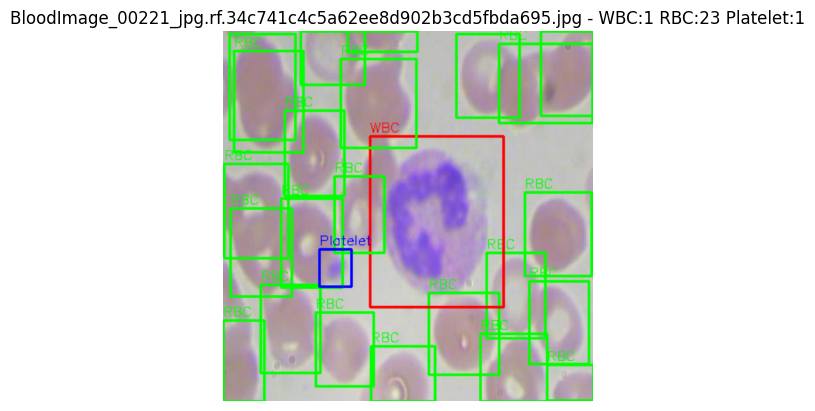


0: 416x416 1 Platelets, 20 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


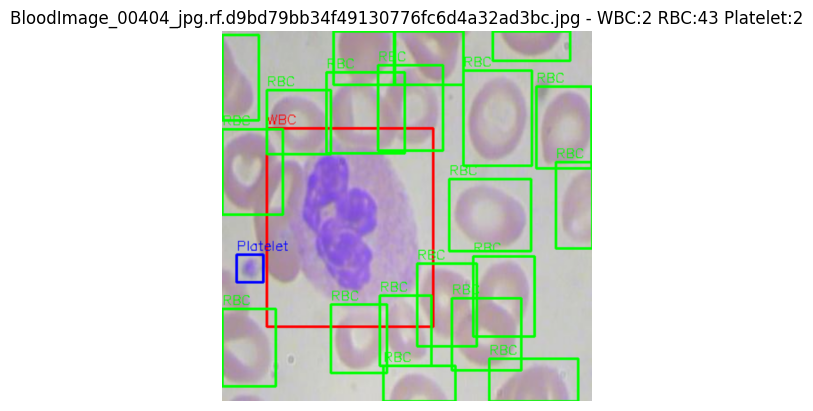


0: 416x416 1 Platelets, 30 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


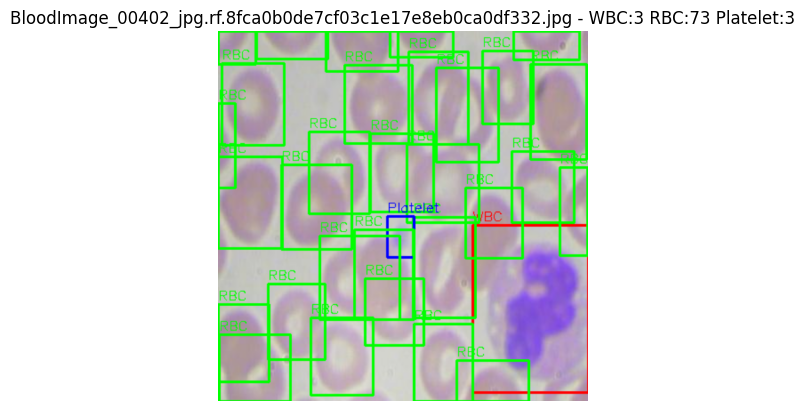


0: 416x416 1 Platelets, 17 RBCs, 1 WBC, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


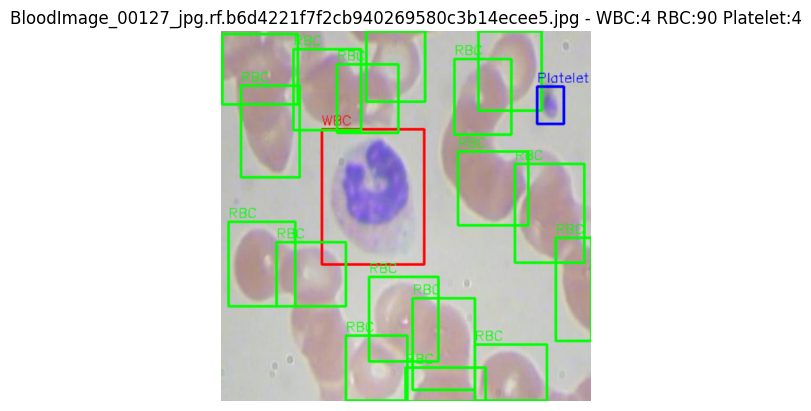


0: 416x416 1 Platelets, 17 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


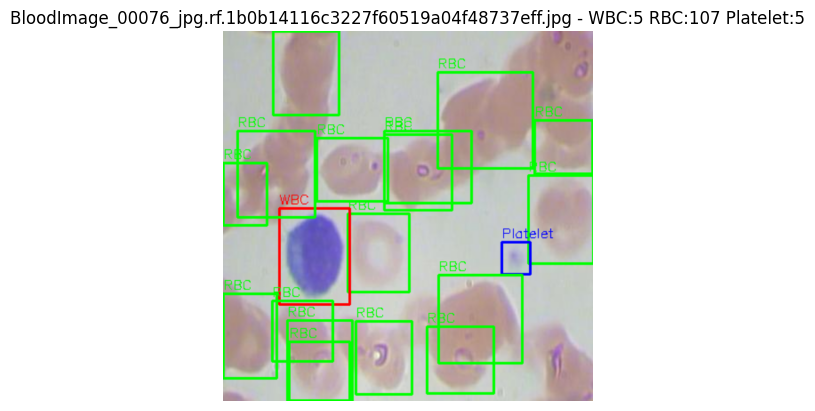


0: 416x416 25 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


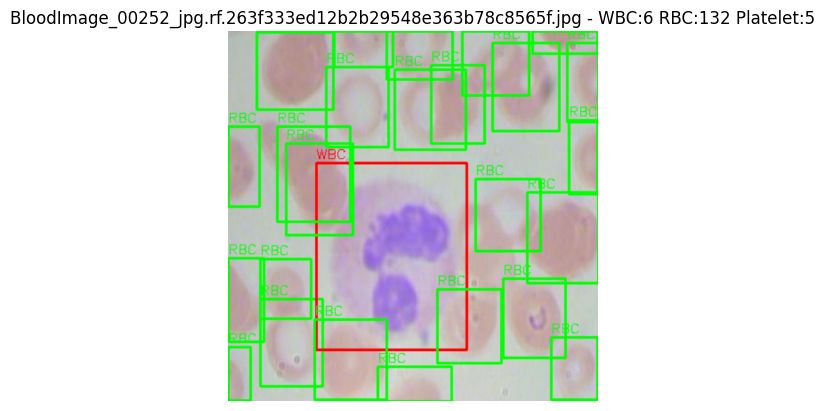


0: 416x416 2 Plateletss, 24 RBCs, 1 WBC, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


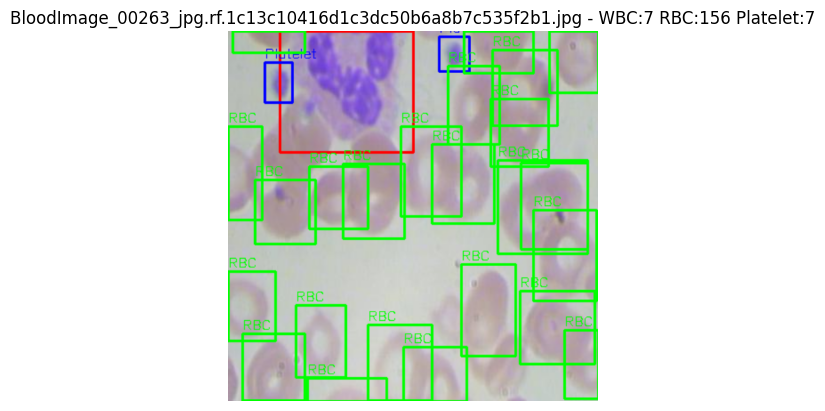


0: 416x416 1 Platelets, 22 RBCs, 1 WBC, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


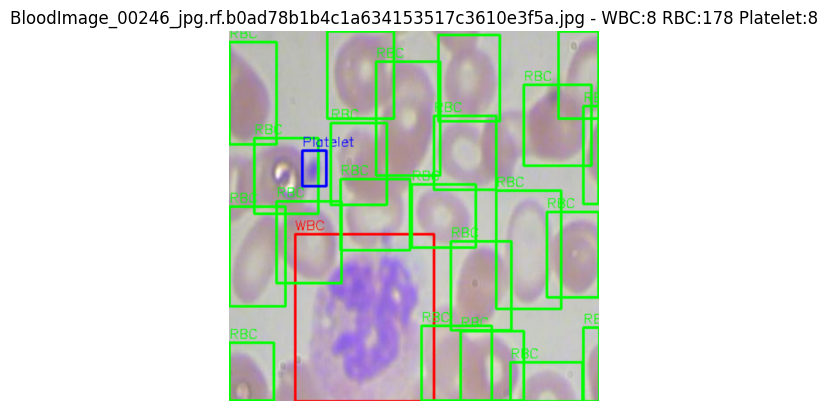


0: 416x416 17 RBCs, 1 WBC, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


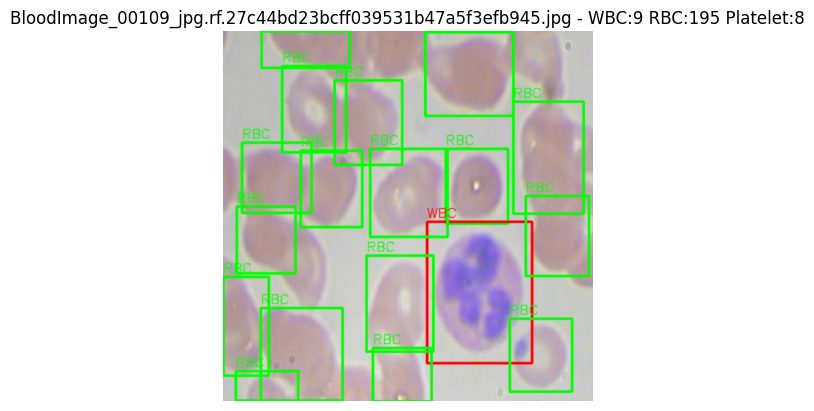


0: 416x416 2 Plateletss, 25 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


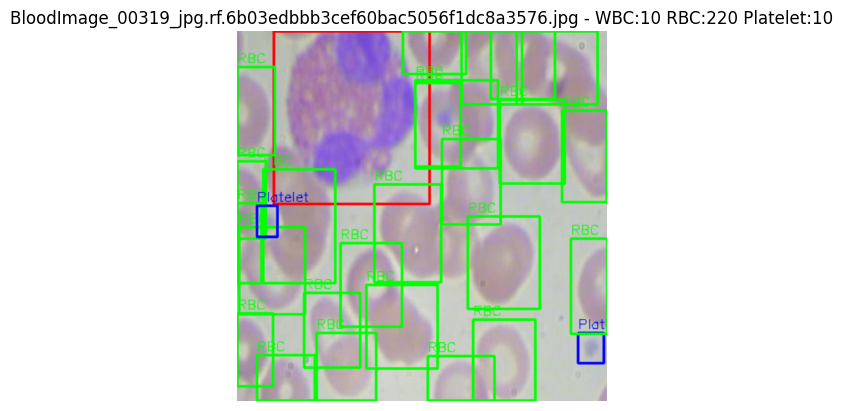


0: 416x416 1 Platelets, 13 RBCs, 1 WBC, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


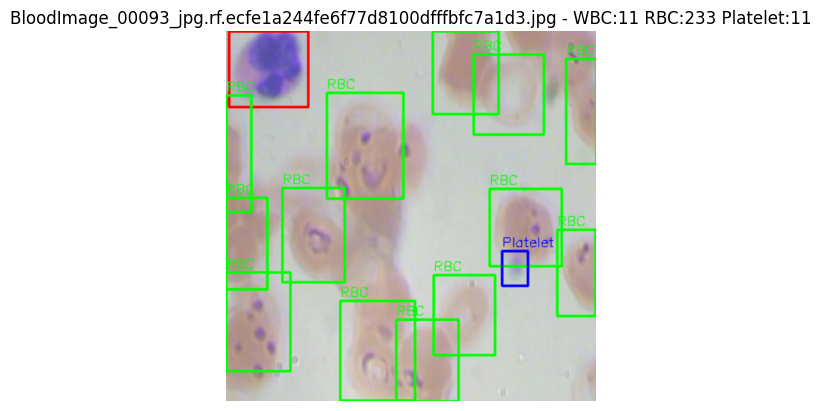


0: 416x416 20 RBCs, 1 WBC, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


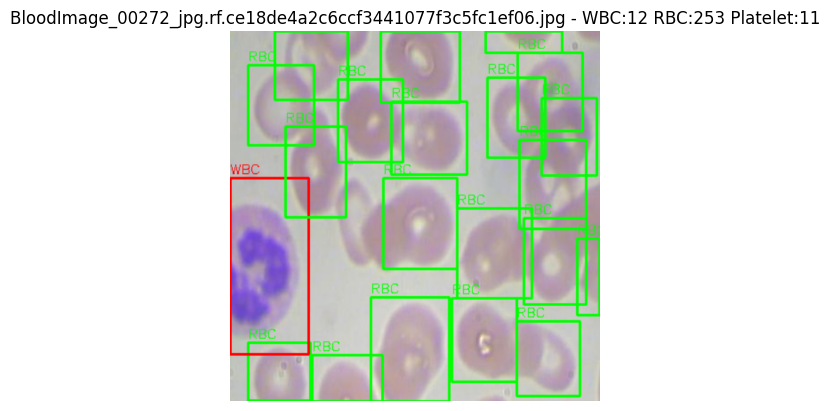


0: 416x416 1 Platelets, 17 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


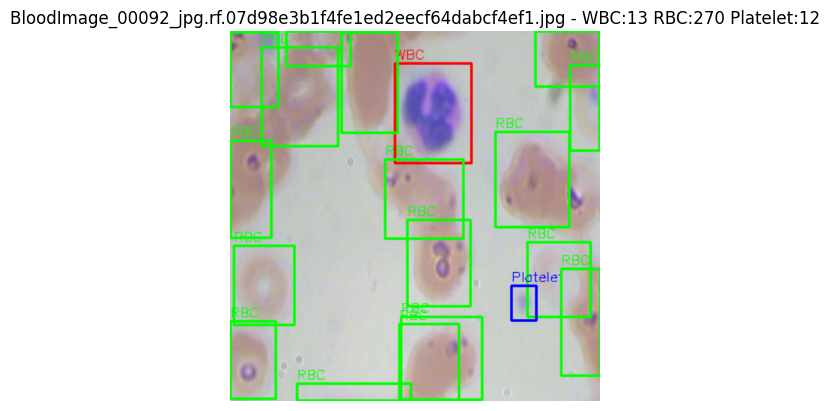


0: 416x416 3 Plateletss, 15 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


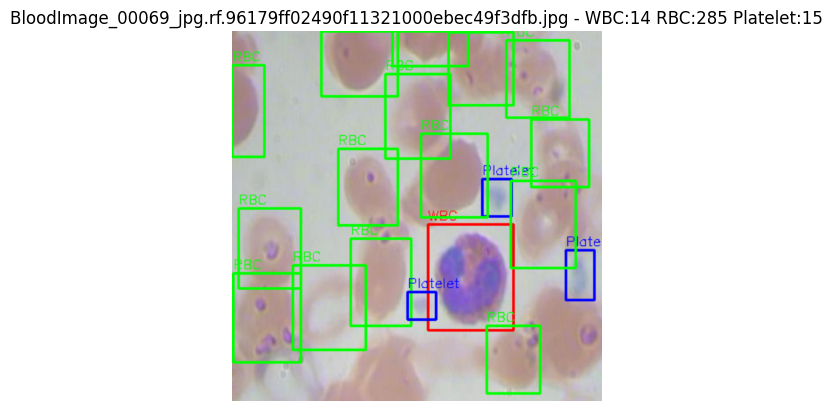


0: 416x416 21 RBCs, 1 WBC, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


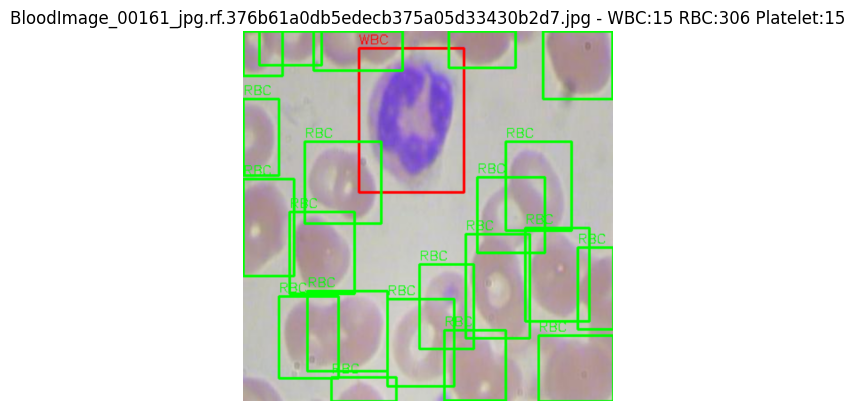


0: 416x416 2 Plateletss, 22 RBCs, 1 WBC, 10.2ms
Speed: 0.9ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


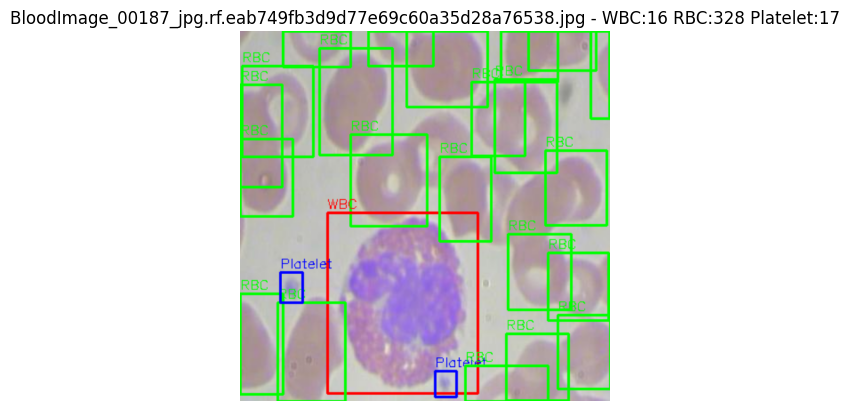


0: 416x416 2 Plateletss, 26 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


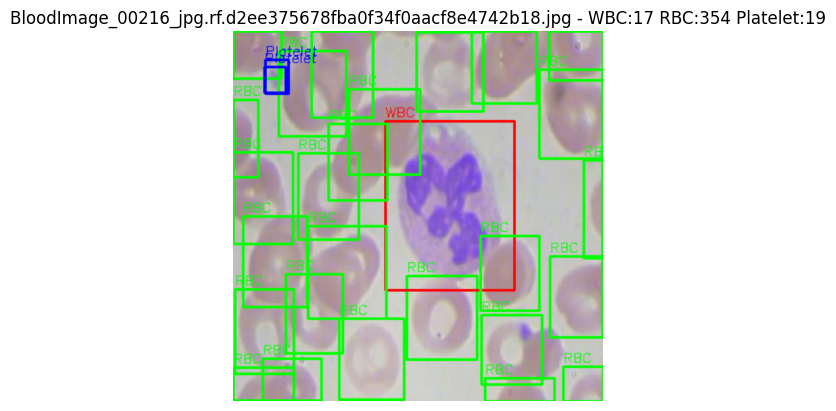


0: 416x416 3 Plateletss, 23 RBCs, 1 WBC, 10.3ms
Speed: 1.5ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


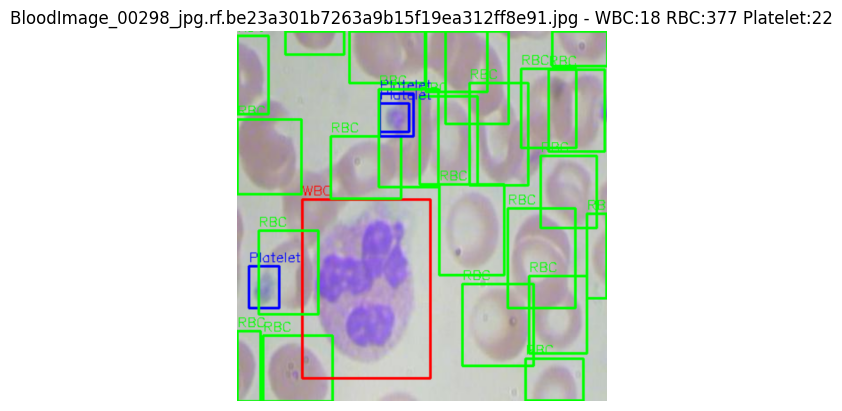


0: 416x416 4 Plateletss, 23 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


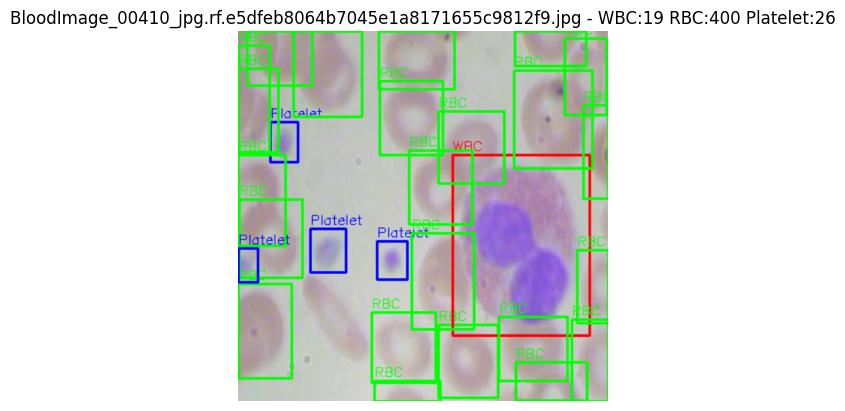


0: 416x416 2 Plateletss, 23 RBCs, 1 WBC, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


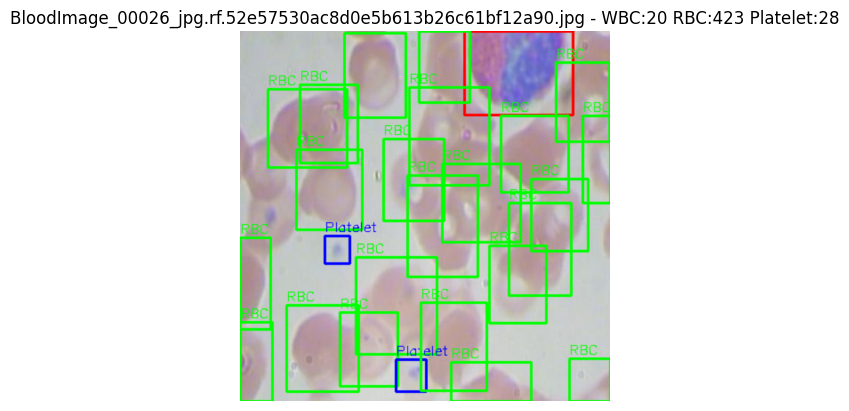


0: 416x416 1 Platelets, 17 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


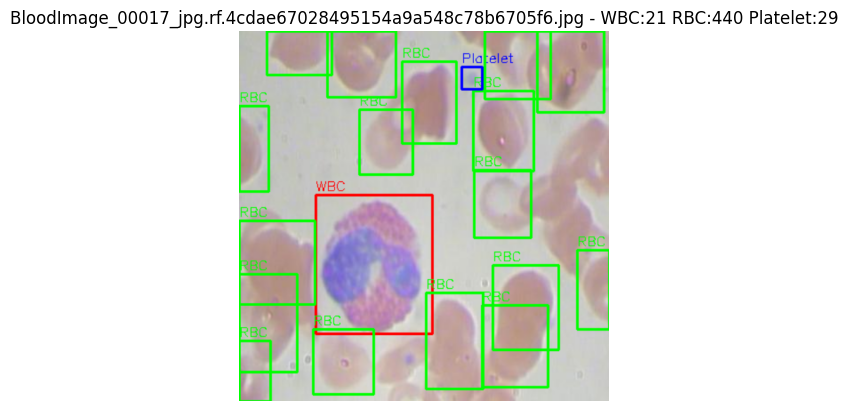


0: 416x416 2 Plateletss, 23 RBCs, 1 WBC, 10.4ms
Speed: 1.5ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


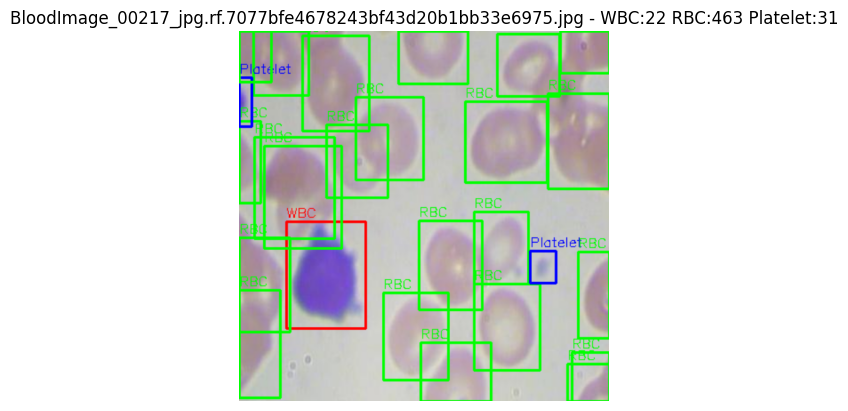


0: 416x416 2 Plateletss, 16 RBCs, 1 WBC, 10.3ms
Speed: 1.7ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


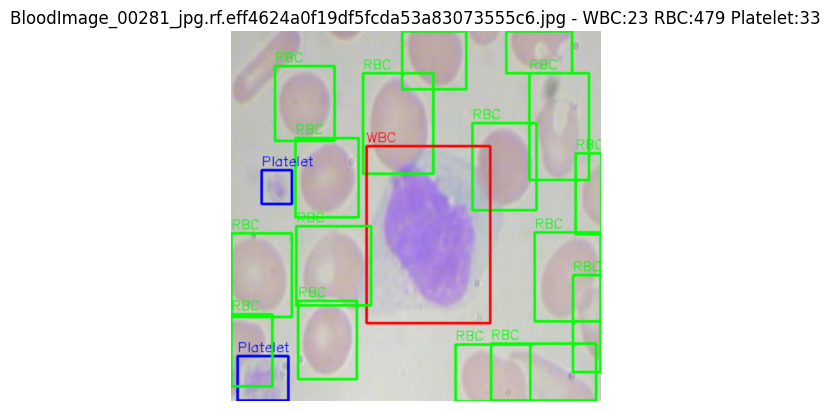


0: 416x416 2 Plateletss, 23 RBCs, 1 WBC, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


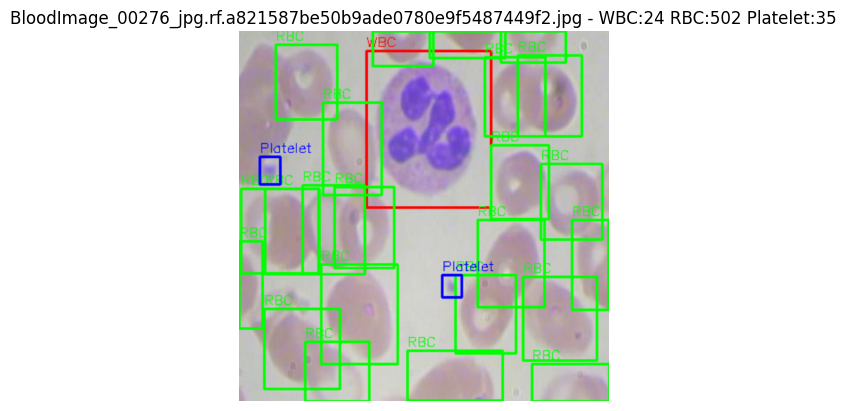


0: 416x416 5 Plateletss, 26 RBCs, 1 WBC, 10.2ms
Speed: 0.9ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


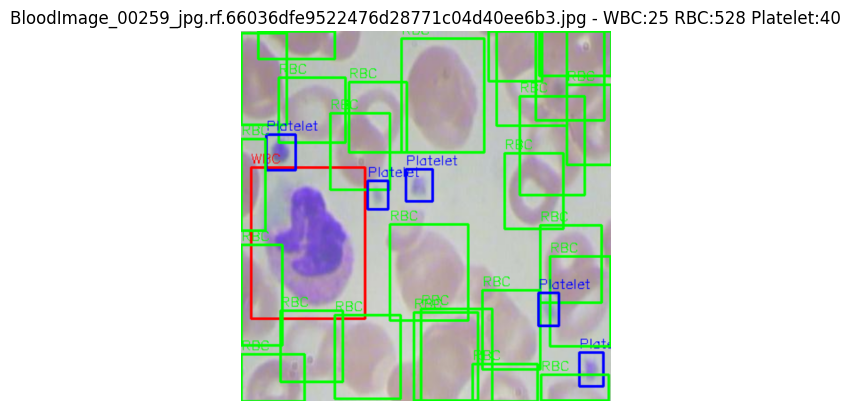


0: 416x416 1 Platelets, 21 RBCs, 1 WBC, 11.3ms
Speed: 1.2ms preprocess, 11.3ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


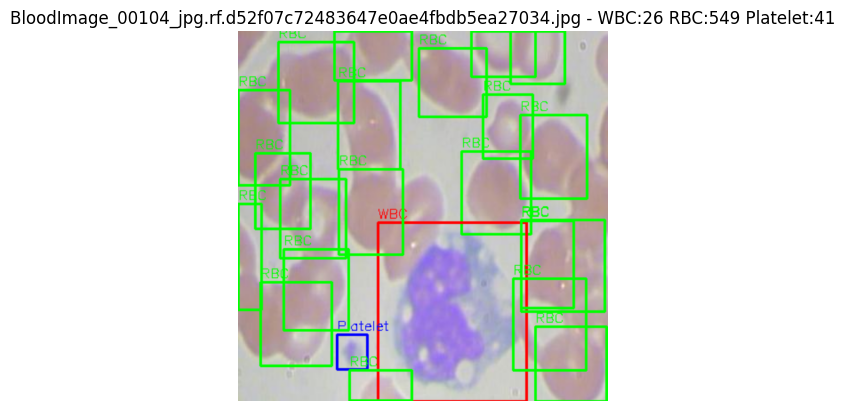


0: 416x416 2 Plateletss, 28 RBCs, 1 WBC, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


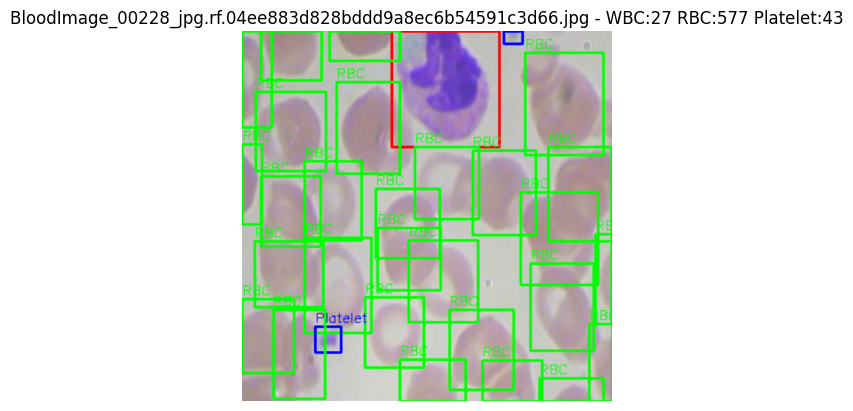


0: 416x416 22 RBCs, 1 WBC, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


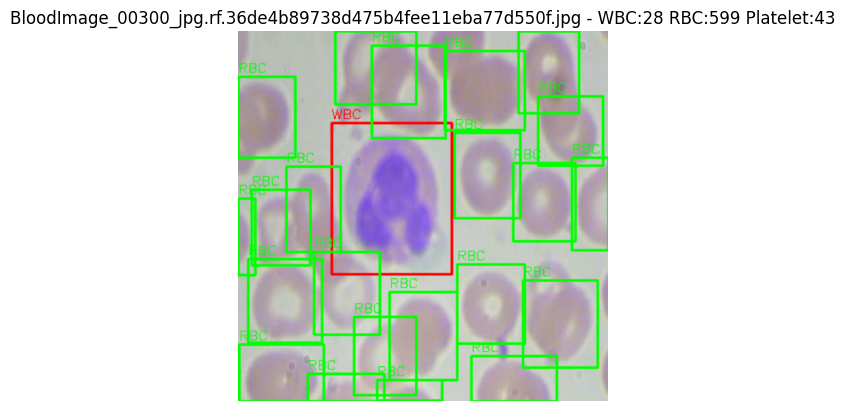


0: 416x416 4 Plateletss, 16 RBCs, 1 WBC, 10.2ms
Speed: 1.2ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


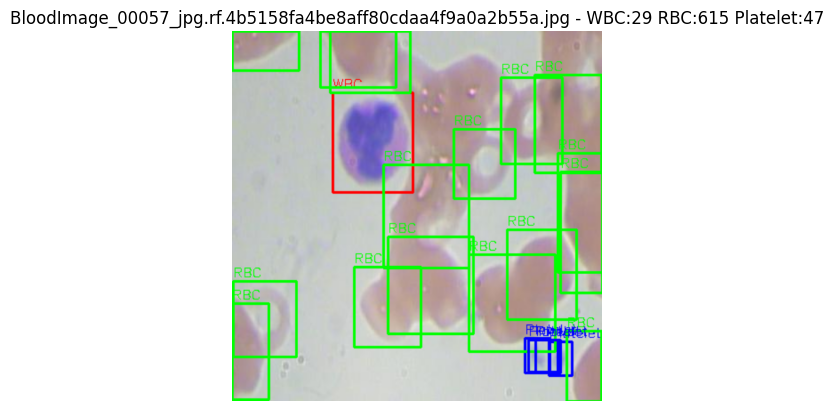


0: 416x416 3 Plateletss, 22 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


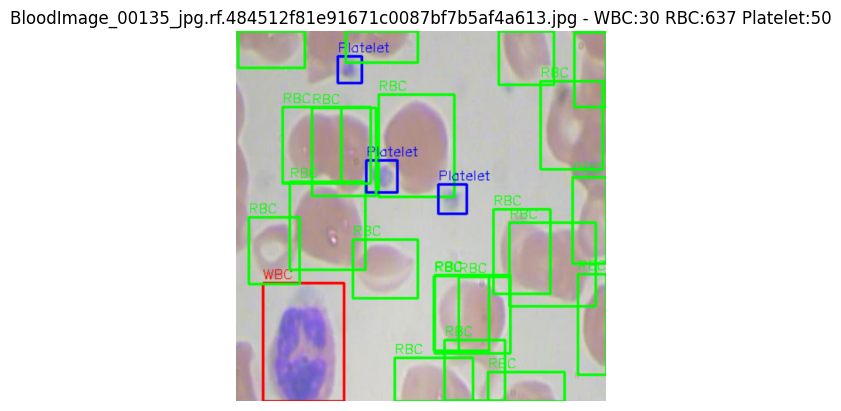


0: 416x416 26 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


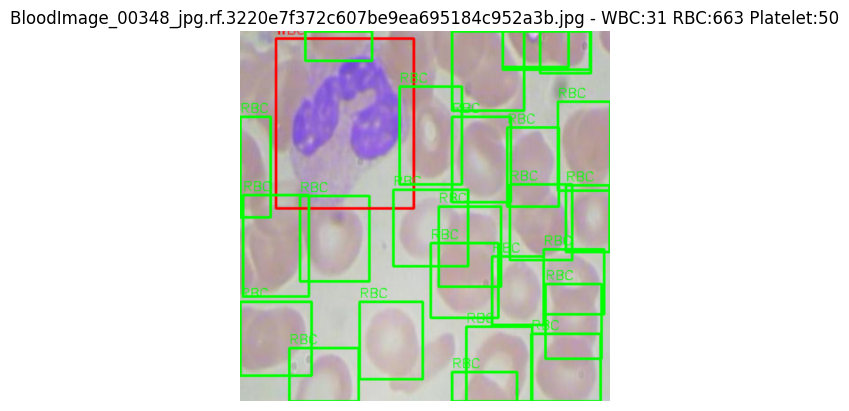


0: 416x416 1 Platelets, 15 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


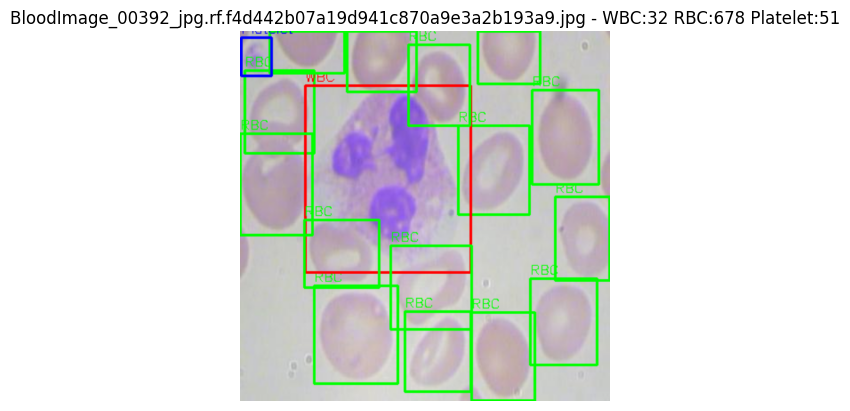


0: 416x416 1 Platelets, 13 RBCs, 2 WBCs, 10.3ms
Speed: 1.3ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


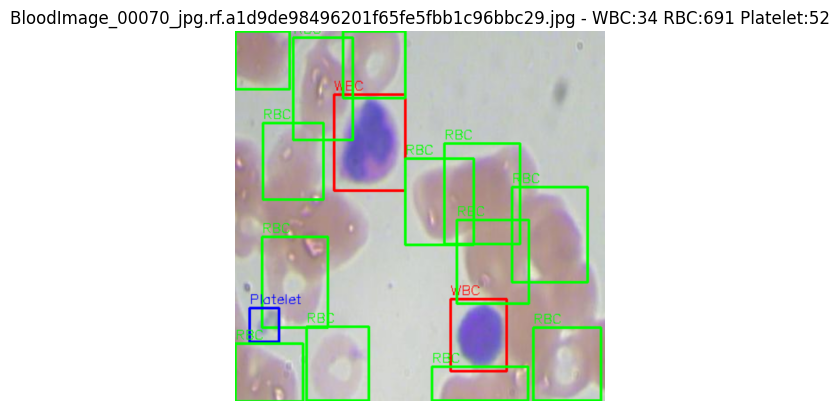


0: 416x416 1 Platelets, 14 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


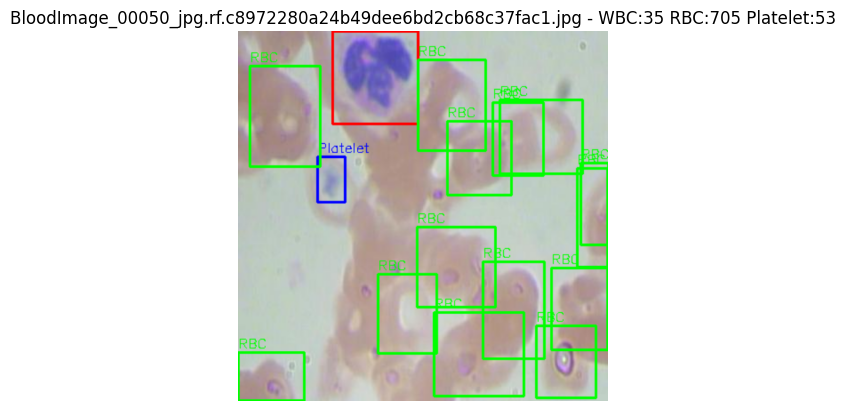


0: 416x416 3 Plateletss, 21 RBCs, 1 WBC, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


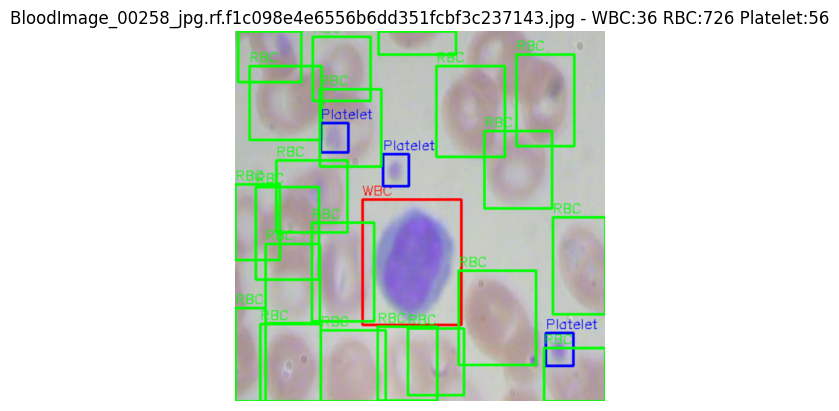


0: 416x416 25 RBCs, 1 WBC, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


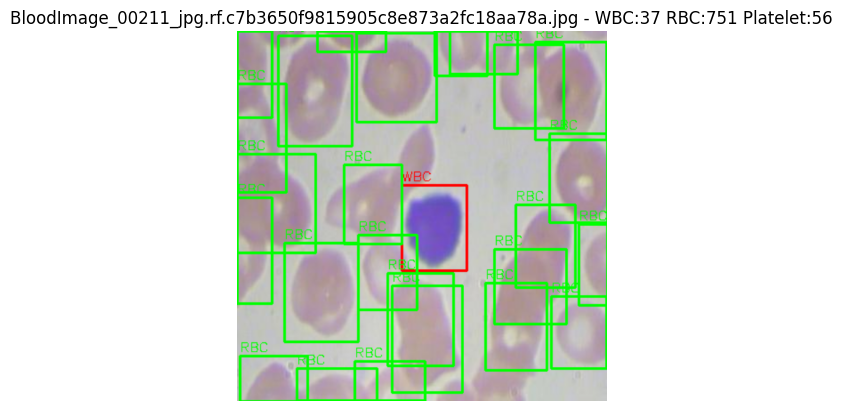


0: 416x416 4 Plateletss, 17 RBCs, 1 WBC, 10.4ms
Speed: 1.5ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


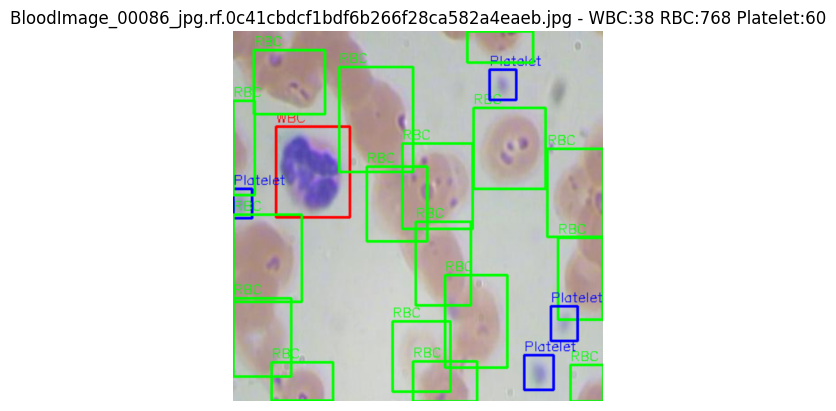


0: 416x416 3 Plateletss, 26 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


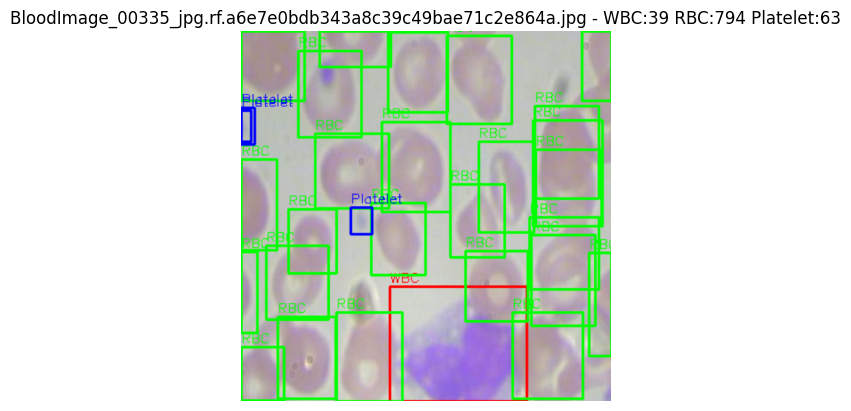


0: 416x416 21 RBCs, 1 WBC, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


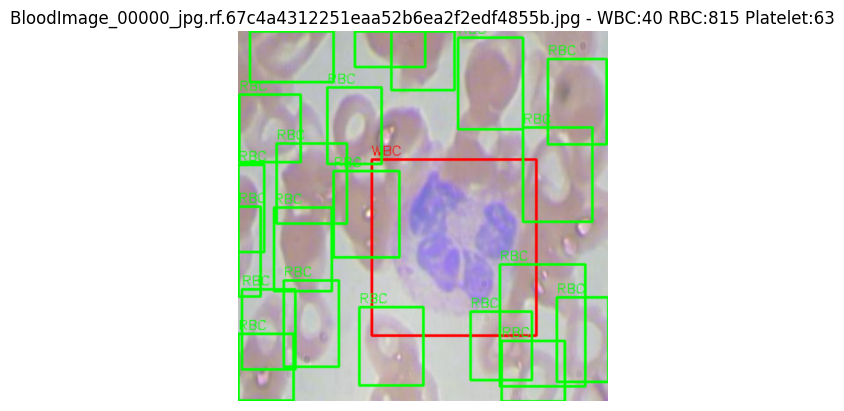


0: 416x416 14 RBCs, 1 WBC, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


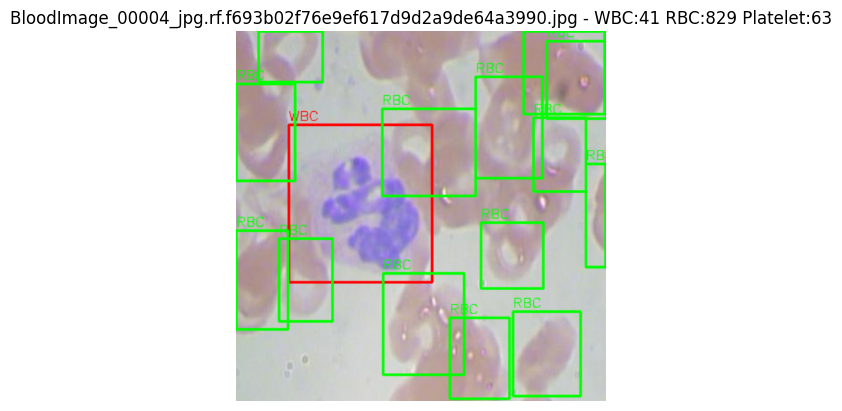


0: 416x416 1 Platelets, 14 RBCs, 1 WBC, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


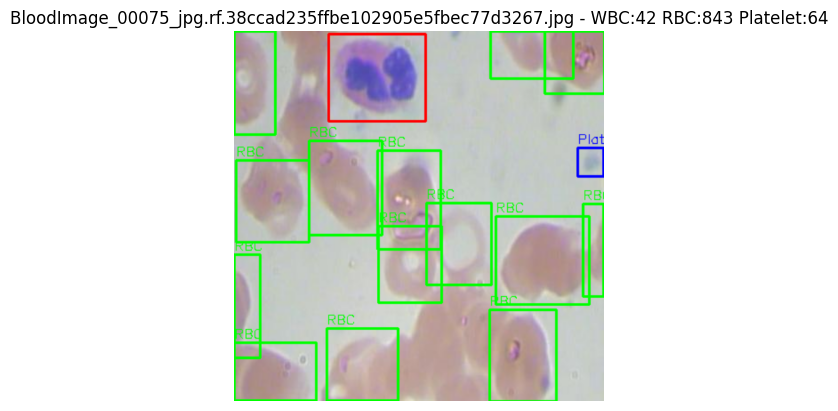


0: 416x416 14 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


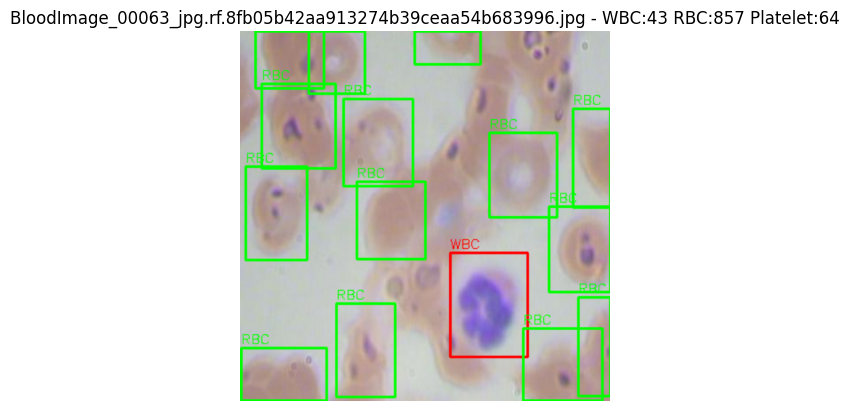


0: 416x416 2 Plateletss, 15 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


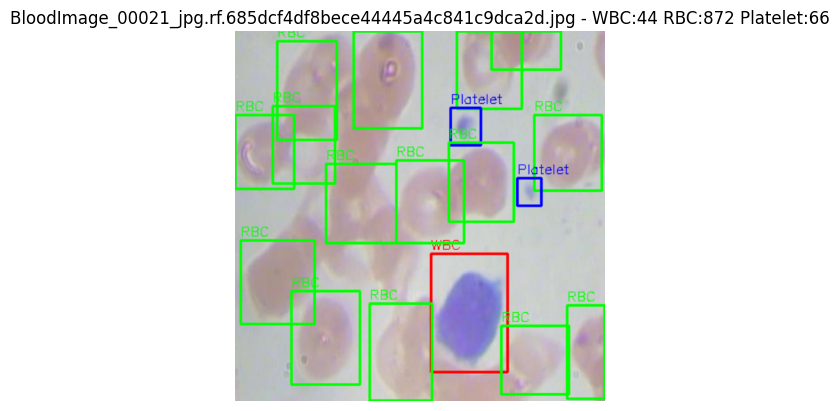


0: 416x416 1 Platelets, 23 RBCs, 1 WBC, 10.2ms
Speed: 1.3ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


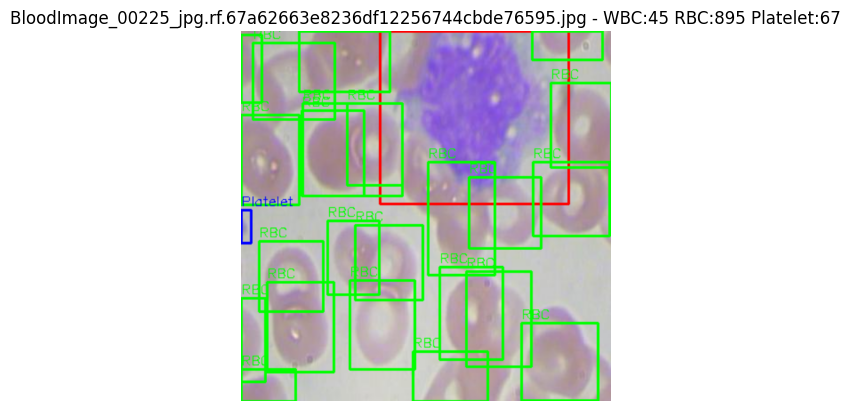


0: 416x416 1 Platelets, 21 RBCs, 2 WBCs, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


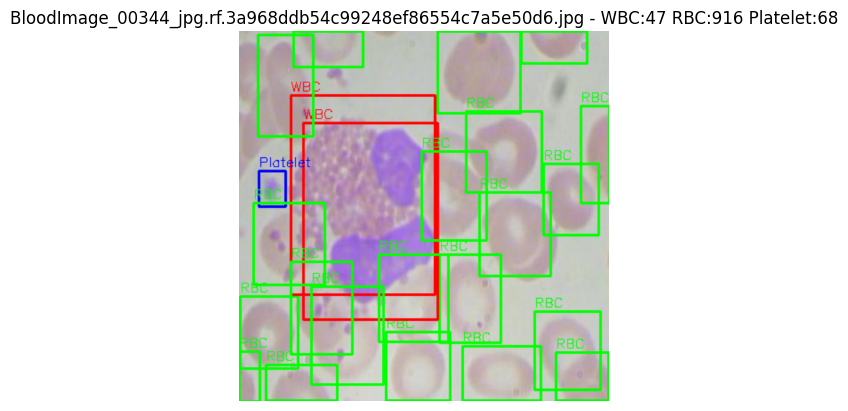


0: 416x416 12 RBCs, 1 WBC, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


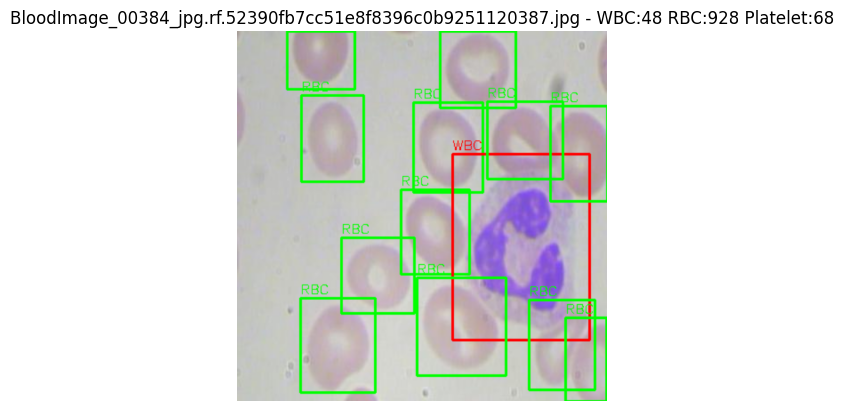


0: 416x416 3 Plateletss, 19 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


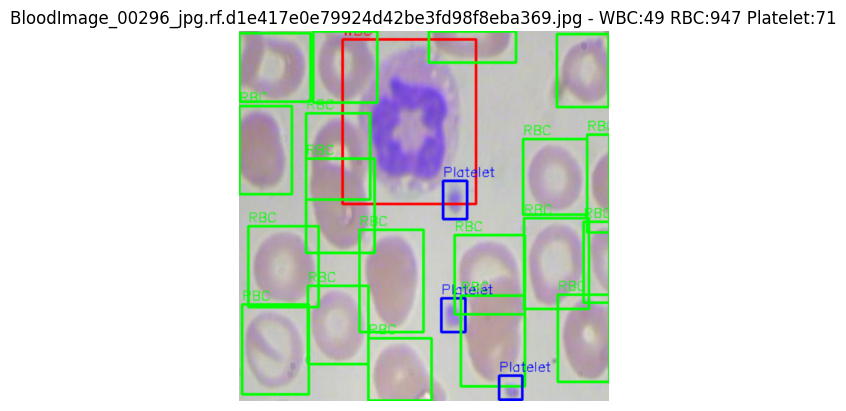


0: 416x416 1 Platelets, 20 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


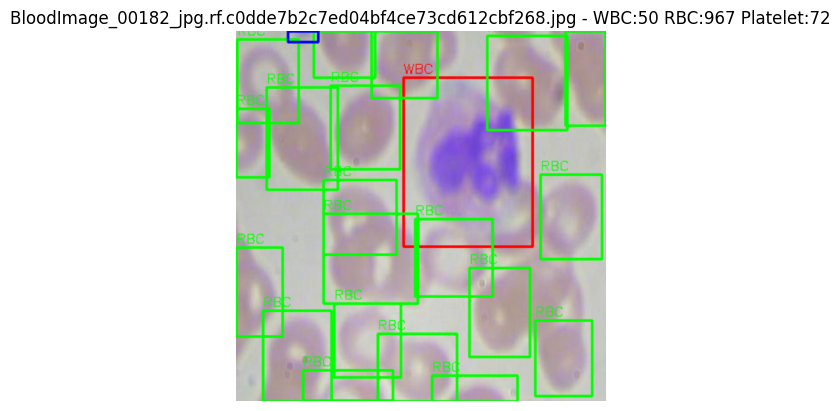


0: 416x416 1 Platelets, 21 RBCs, 1 WBC, 10.7ms
Speed: 1.6ms preprocess, 10.7ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


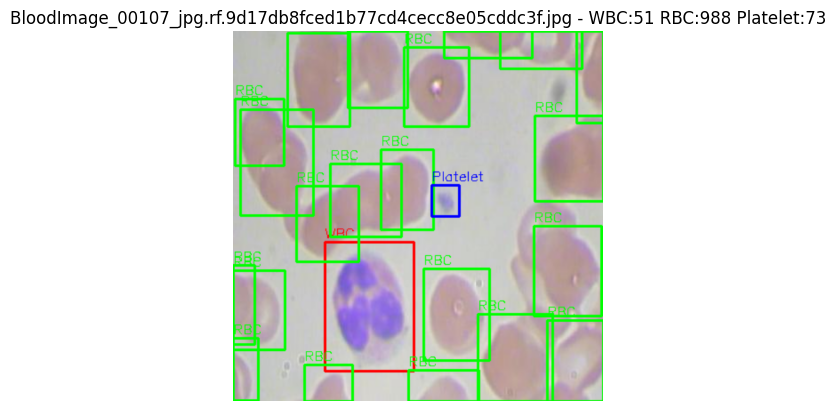


0: 416x416 2 Plateletss, 20 RBCs, 1 WBC, 10.4ms
Speed: 1.5ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


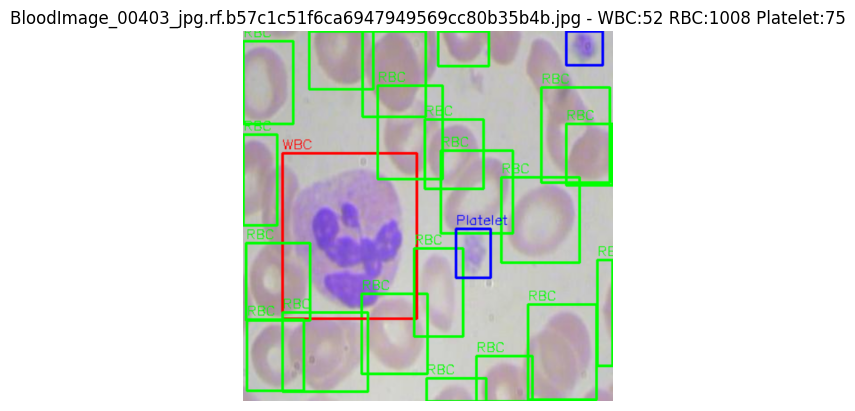


0: 416x416 1 Platelets, 26 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


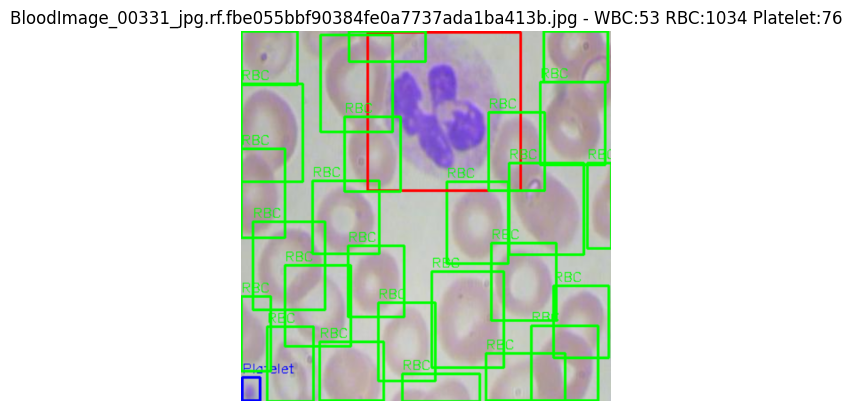


0: 416x416 1 Platelets, 20 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


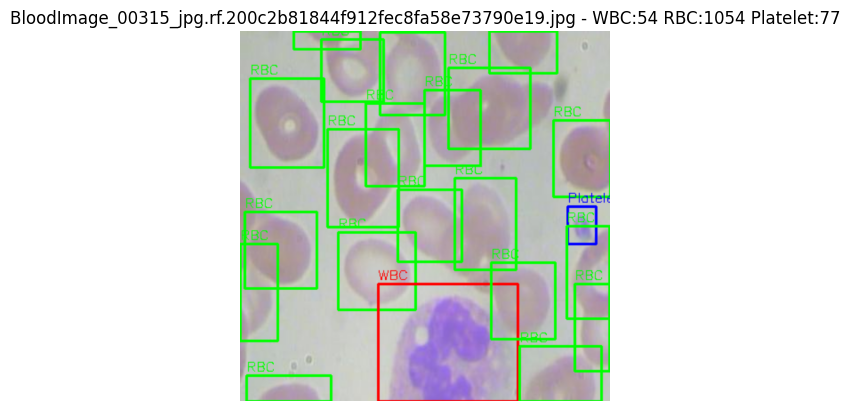


0: 416x416 2 Plateletss, 23 RBCs, 2 WBCs, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


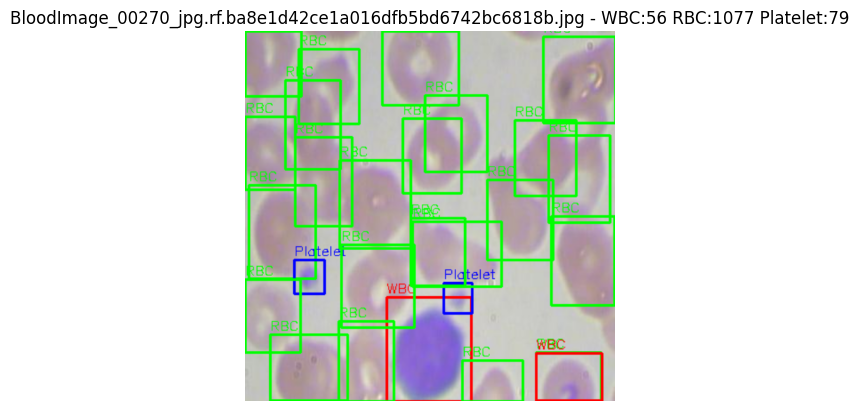


0: 416x416 1 Platelets, 23 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


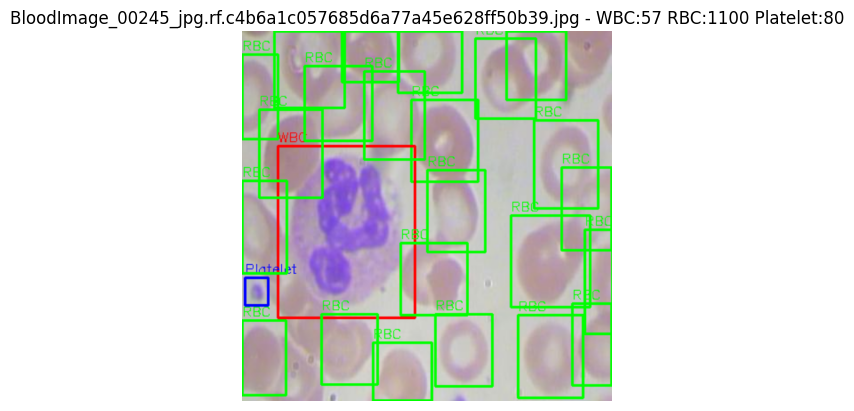


0: 416x416 2 Plateletss, 20 RBCs, 1 WBC, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


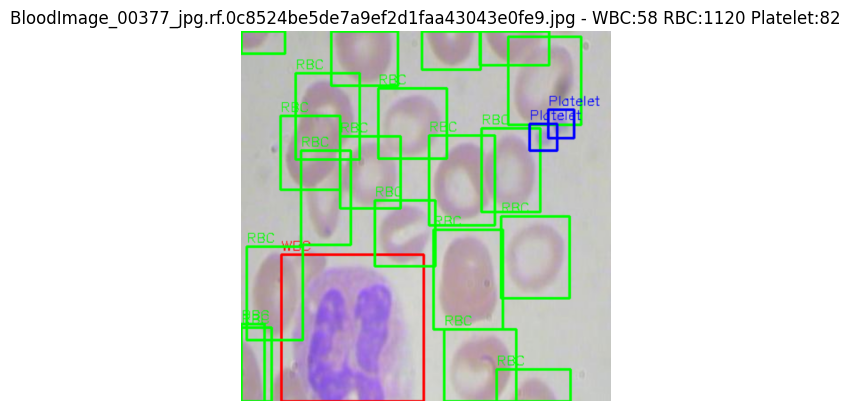


0: 416x416 20 RBCs, 1 WBC, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


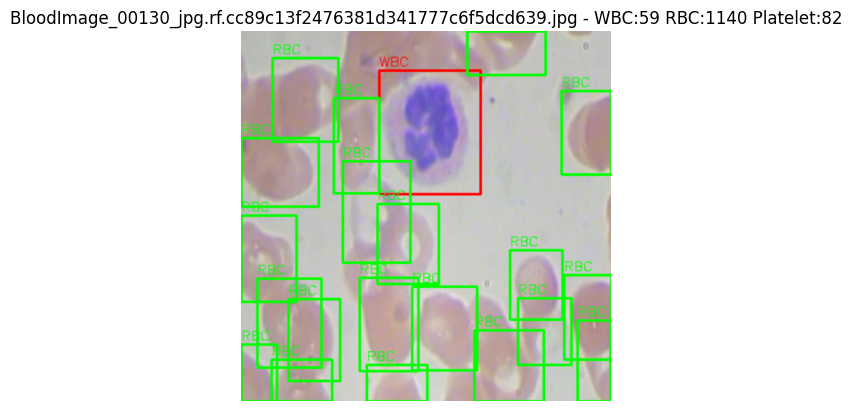


0: 416x416 2 Plateletss, 19 RBCs, 1 WBC, 10.4ms
Speed: 1.4ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


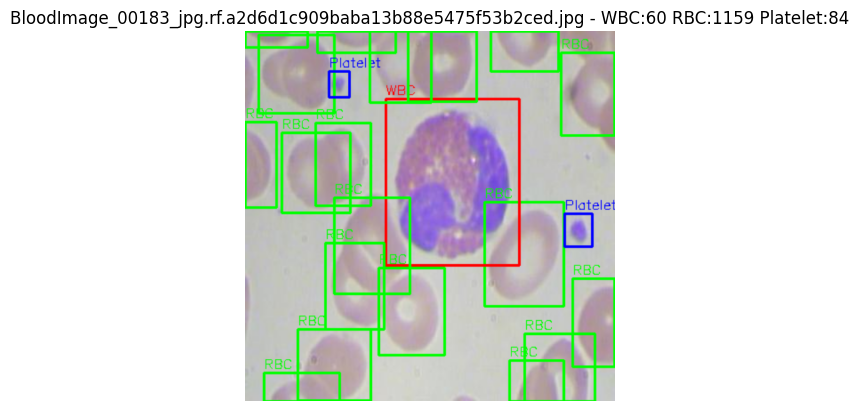


0: 416x416 1 Platelets, 21 RBCs, 1 WBC, 10.4ms
Speed: 1.4ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


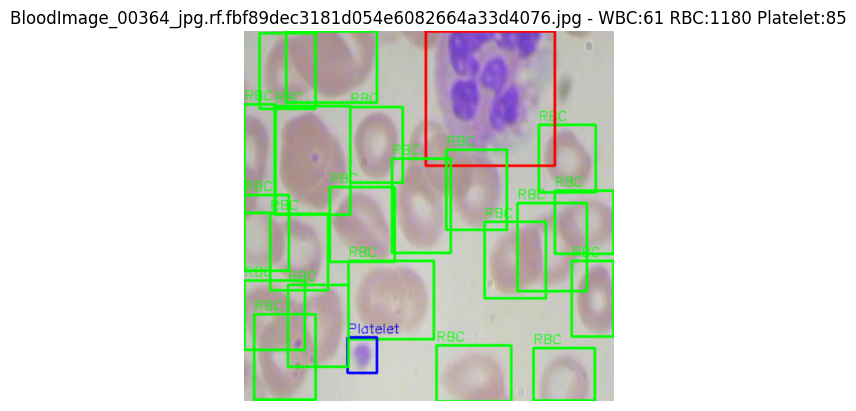


0: 416x416 25 RBCs, 1 WBC, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


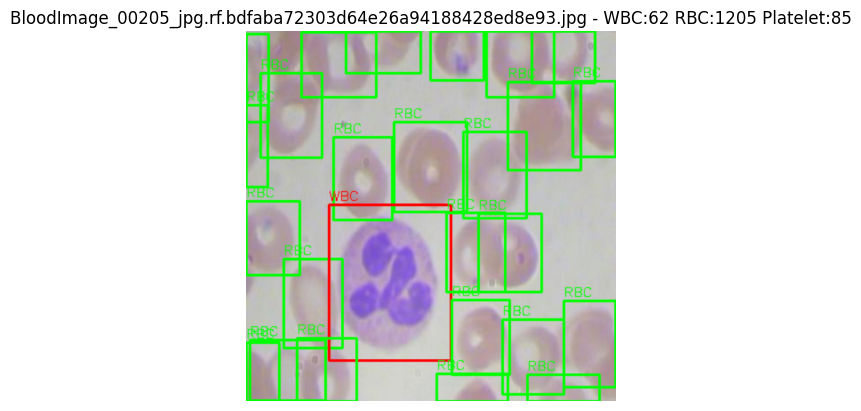


0: 416x416 1 Platelets, 26 RBCs, 1 WBC, 10.4ms
Speed: 1.3ms preprocess, 10.4ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


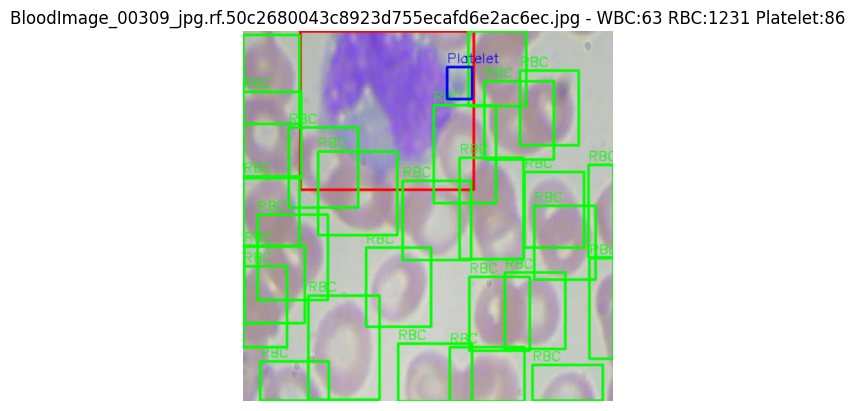


0: 416x416 2 Plateletss, 14 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


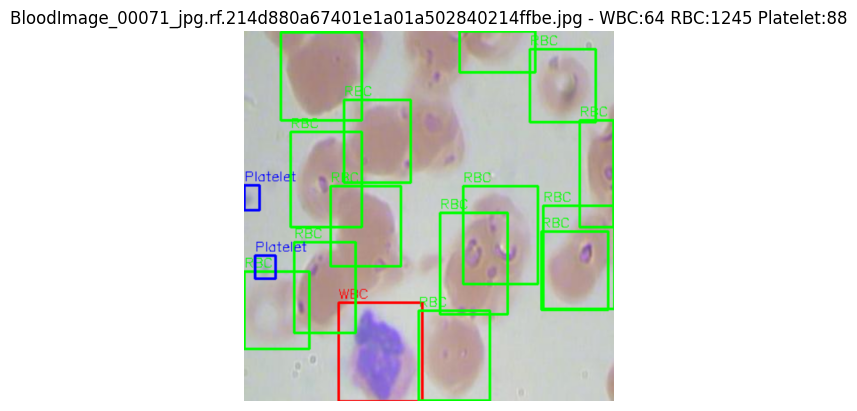


0: 416x416 1 Platelets, 23 RBCs, 1 WBC, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


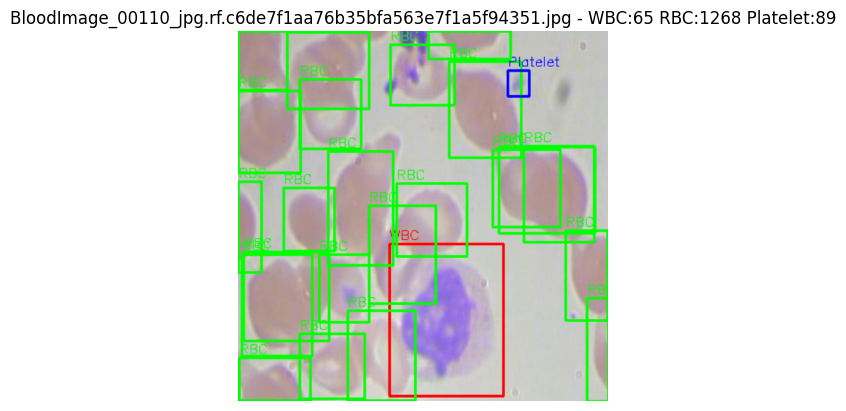


0: 416x416 2 Plateletss, 19 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


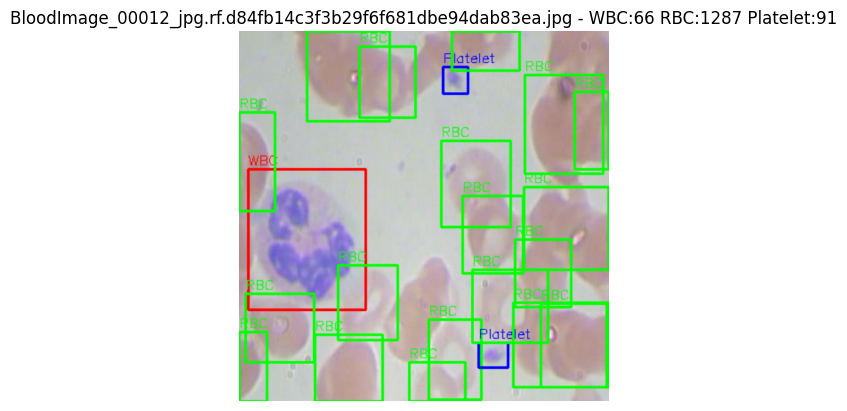


0: 416x416 23 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


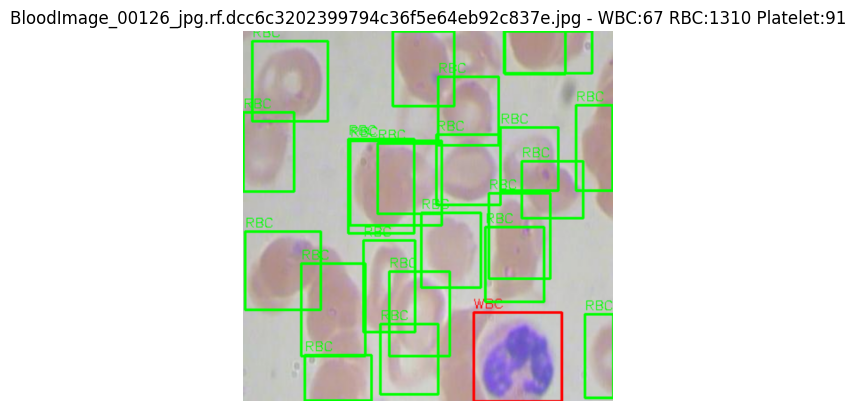


0: 416x416 1 Platelets, 18 RBCs, 1 WBC, 10.2ms
Speed: 1.0ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


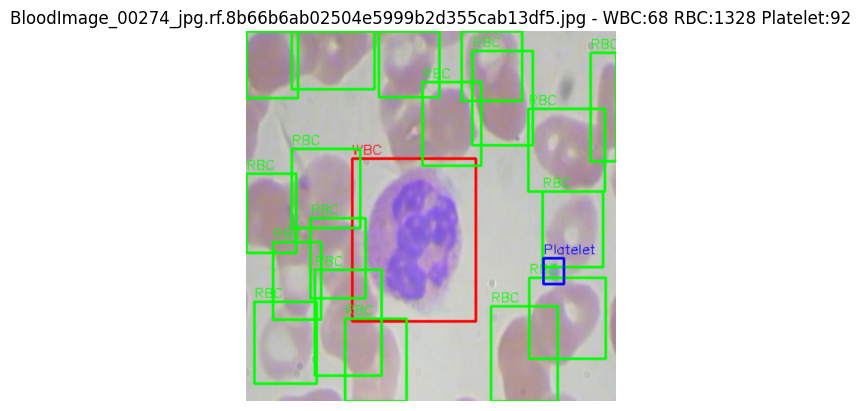


0: 416x416 18 RBCs, 1 WBC, 10.3ms
Speed: 1.5ms preprocess, 10.3ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


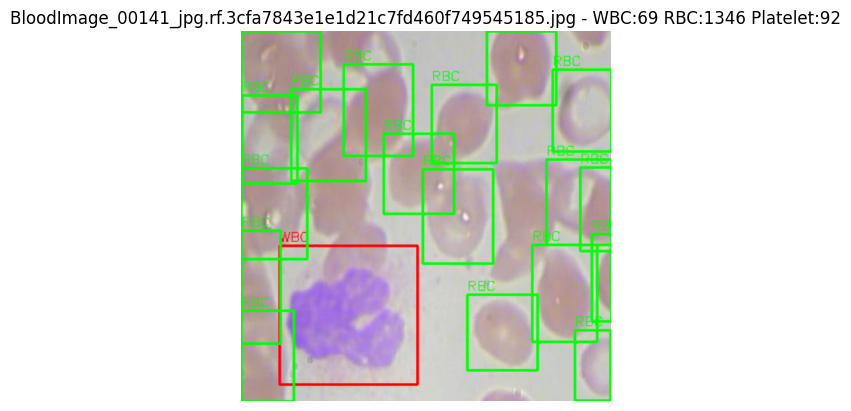


0: 416x416 1 Platelets, 21 RBCs, 1 WBC, 10.2ms
Speed: 1.4ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


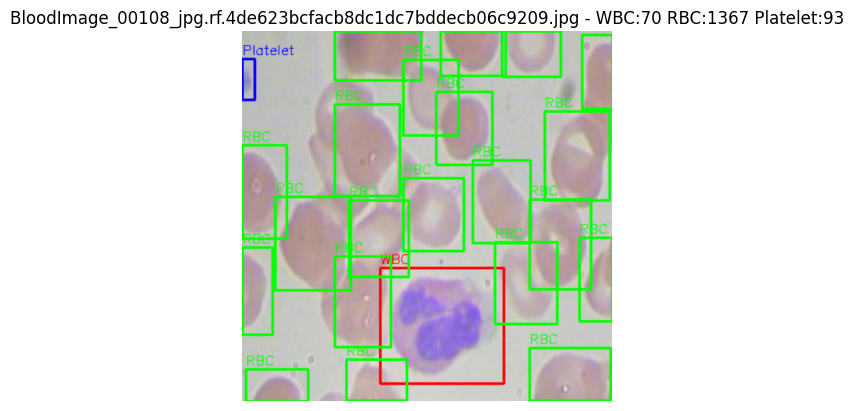


0: 416x416 2 Plateletss, 23 RBCs, 1 WBC, 10.4ms
Speed: 1.5ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


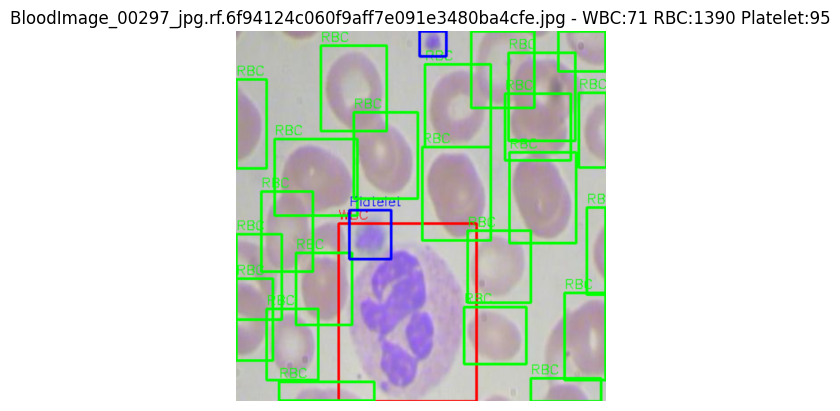


0: 416x416 22 RBCs, 1 WBC, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


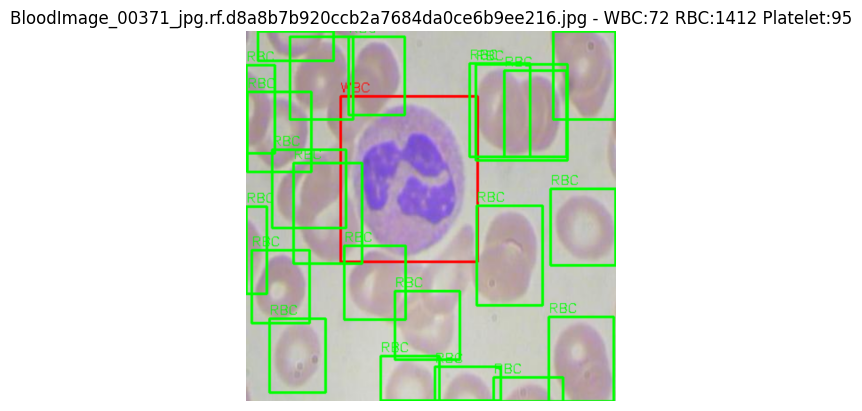


0: 416x416 2 Plateletss, 24 RBCs, 2 WBCs, 10.2ms
Speed: 1.1ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 416, 416)


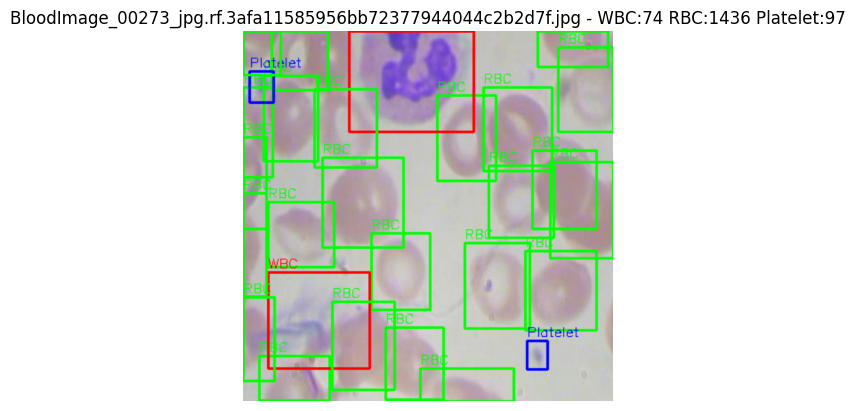


0: 416x416 16 RBCs, 1 WBC, 10.3ms
Speed: 1.4ms preprocess, 10.3ms inference, 2.3ms postprocess per image at shape (1, 3, 416, 416)


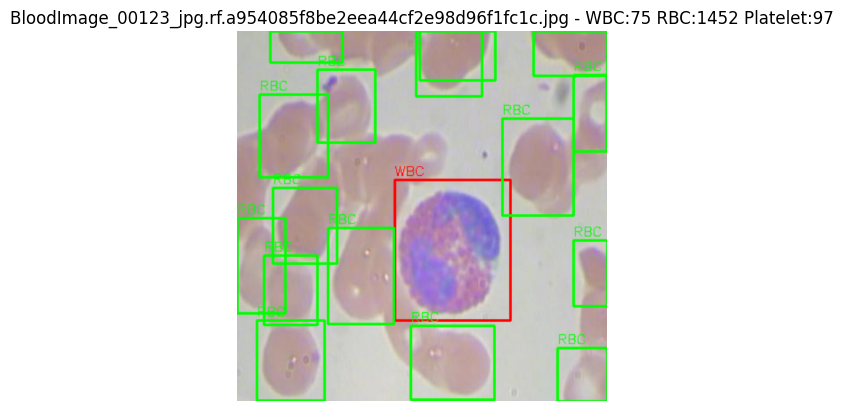


0: 416x416 1 Platelets, 21 RBCs, 1 WBC, 10.2ms
Speed: 1.5ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


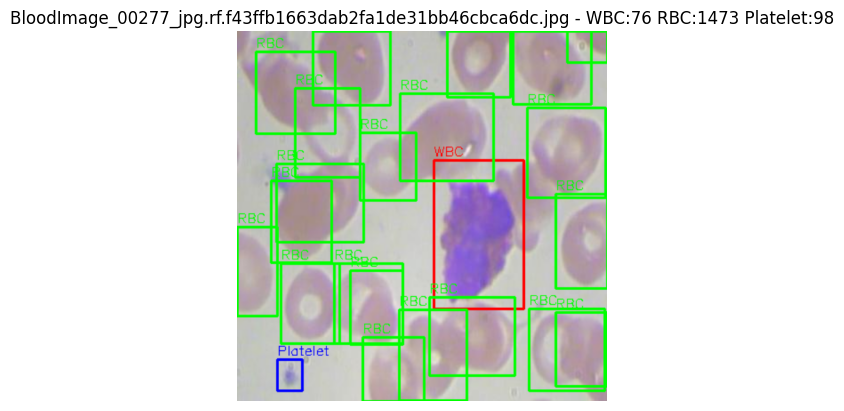


0: 416x416 4 Plateletss, 25 RBCs, 1 WBC, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 416, 416)


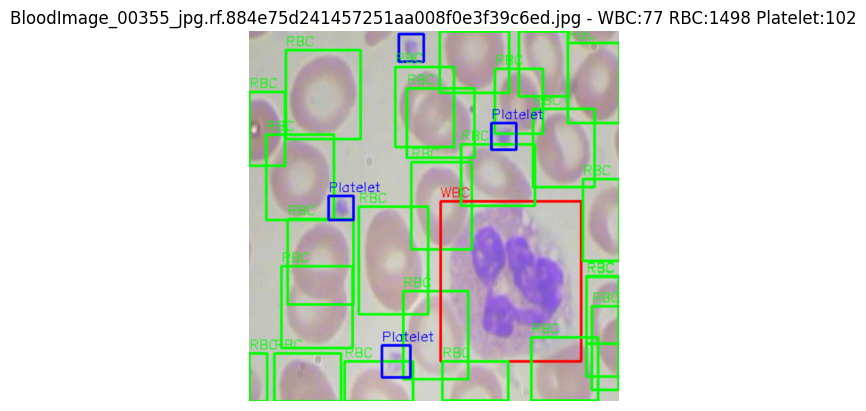


Segmentation Complete! Final Counts:
   - WBC: 77
   - RBC: 1498
   - Platelet: 102
Segmented Cell Counts:
   - WBC: 77
   - RBC: 1498
   - Platelet: 102
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Image: BloodImage_00086_jpg.rf.0c41cbdcf1bdf6b266f28ca582a4eaeb_WBC_38.png, Predicted Class: MONOCYTE
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Image: BloodImage_00403_jpg.rf.b57c1c51f6ca6947949569cc80b35b4b_WBC_52.png, Predicted Class: MONOCYTE
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Image: BloodImage_00057_jpg.rf.4b5158fa4be8aff80cdaa4f9a0a2b55a_WBC_29.png, Predicted Class: MONOCYTE
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Image: BloodImage_00281_jpg.rf.eff4624a0f19df5fcda53a83073555c6_WBC_23.png, Predicted Class: MONOCYTE
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: BloodImage_00315_jpg.rf.200c2b81844f912fec8fa58e73790e19_WBC_54.png, Predicted Class: MONOCYTE
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Image: BloodImage_00297_jpg.rf.6f94124c060f9aff7e091e3480ba4cfe_WBC_71.png, Predicted Class: MONOCYTE
1/1 ━

In [83]:
input_folder = "/kaggle/input/bccd-complete/BCCD/valid/images"
main(input_folder)

In [81]:
import os
import shutil

def clear_folder(folder_path):
    """Deletes all files inside the specified folder."""
    if os.path.exists(folder_path):
        shutil.rmtree(folder_path)  # Remove the folder and its contents
        os.makedirs(folder_path)    # Recreate an empty folder
        print(f"Cleared folder: {folder_path}")
    else:
        os.makedirs(folder_path)  # Ensure the folder exists
        print(f"Created folder: {folder_path}")
clear_folder("/kaggle/working/segmented_cells")

Cleared folder: /kaggle/working/segmented_cells
